In [1]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")

In [2]:
Asset_PATH = "/home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/"

#### Plotting function give top density value validation set and prediction set

In [251]:
def PlotTS(X_valid,Y_valid,model,top=10):
    Predict = model.predict(X_valid)
    #columns = []
    #colNames = []
    pixelIndexDict = {}

    for ts,listOfTopTen in enumerate(np.argsort(Y_valid)[:,:,-top:][0]):
        #print(ts,listOfTopTen)
        for i in listOfTopTen:
            if (not (i in pixelIndexDict.keys())):
                pixelIndexDict[i] = {"columns":[],"colNames":[]}

            pixelIndexDict[i]["columns"].append(Y_valid[:,ts,i])
            pixelIndexDict[i]["colNames"].append("Y_valid: "+"Pixel: "+str(i)+" Future: " + str(int((ts+1)*7)) + " days")
            pixelIndexDict[i]["columns"].append(Predict[:,ts,i])
            pixelIndexDict[i]["colNames"].append("Predict: "+"Pixel: "+str(i)+" Future: " + str(int((ts+1)*7)) + " days")

    for i in pixelIndexDict.keys():
        #columns = []
        #colNames = []    
        pd.DataFrame(np.transpose(np.vstack(pixelIndexDict[i]["columns"])),
                 columns=pixelIndexDict[i]["colNames"]).plot(figsize=(12,6))


#### Timeseries windowing function

In [3]:
def window_stack(a, stepsize=1, width=52):
    n = a.shape[0]
    return np.hstack( a[i:1+n+i-width:stepsize] for i in range(0,width) )

#### Window size X

In [4]:
timesteps = 52

#### Window size Y

In [5]:
timestepY = 4 #weeks
timestepY

4

#### Load Gaussian KDE timeseries

In [6]:
density_matrix_t_series = pickle.load(open(Asset_PATH  + 'density_matrix_t_series_25x25.pickle', 'rb'))

In [7]:
density_matrix_t_series.shape

(1011, 25, 25)

In [8]:
print(np.max(density_matrix_t_series))
print(np.min(density_matrix_t_series))

7464.852345565599
2.220446049250313e-16


In [9]:
flattened_matrix_np = np.reshape(density_matrix_t_series, 
                                 (density_matrix_t_series.shape[0],
                                  density_matrix_t_series.shape[1]*density_matrix_t_series.shape[2]))
flattened_matrix_np.shape

(1011, 625)

In [10]:
stacked = window_stack(flattened_matrix_np,1,timesteps)
stacked.shape

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  This is separate from the ipykernel package so we can avoid doing imports until


(960, 32500)

In [11]:
stackedY = window_stack(flattened_matrix_np,1,timestepY)
stackedY.shape

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: arrays to stack must be passed as a "sequence" type such as list or tuple. Support for non-sequence iterables such as generators is deprecated as of NumPy 1.16 and will raise an error in the future.
  This is separate from the ipykernel package so we can avoid doing imports until


(1008, 2500)

In [12]:
train, valid = (60,20)
test = 20

total_len = stacked.shape[0] - timestepY
train_index = range(0,int(train/100*total_len))

valid_index = range(train_index[-1]+1,train_index[-1] + int(valid/100*total_len))
test_index = range(valid_index[-1]+1,valid_index[-1] + int(test/100*total_len))

In [13]:
train_index, valid_index, test_index

(range(0, 573), range(573, 763), range(763, 953))

#### MinMax Scaler

In [14]:
scaler_max = np.max(stacked[train_index])
scaler_min = np.min(stacked[train_index])

#### We transform the whole train, valid, test based on scaler fitted on train

In [15]:
np.max(flattened_matrix_np)

7464.852345565599

In [16]:
scaled_flattened_matrix = (stacked - scaler_min)/(scaler_max - scaler_min)
scaled_flattened_matrix.shape

(960, 32500)

In [17]:
scaled_flattened_matrixY = (stackedY - scaler_min)/(scaler_max - scaler_min)
scaled_flattened_matrixY.shape

(1008, 2500)

In [18]:
print(np.max(scaled_flattened_matrix))
print(np.min(scaled_flattened_matrix))
print(np.max(scaled_flattened_matrixY))
print(np.min(scaled_flattened_matrixY))

1.7283221574388663
0.0
1.7283221574388663
0.0


In [19]:
print(scaled_flattened_matrix.shape)
print(scaled_flattened_matrixY.shape)

(960, 32500)
(1008, 2500)


In [20]:
reshape_stack = scaled_flattened_matrix.reshape(scaled_flattened_matrix.shape[0],timesteps,
                                int((scaled_flattened_matrix.shape[1]/timesteps)**(1/2)),
                                int((scaled_flattened_matrix.shape[1]/timesteps)**(1/2)),1)
reshape_stack.shape

(960, 52, 25, 25, 1)

In [21]:
reshape_stackY = scaled_flattened_matrixY.reshape(scaled_flattened_matrixY.shape[0],timestepY,
                                int((scaled_flattened_matrixY.shape[1]/timestepY)**(1/2)),
                                int((scaled_flattened_matrixY.shape[1]/timestepY)**(1/2)),1)
reshape_stackY.shape

(1008, 4, 25, 25, 1)

#### We reshape to (sample, timestep, inputshape)

In [22]:
scaled_flattened_matrix = reshape_stack
scaled_flattened_matrix.shape

(960, 52, 25, 25, 1)

In [23]:
scaled_flattened_matrixY = reshape_stackY
scaled_flattened_matrixY.shape

(1008, 4, 25, 25, 1)

#### We set the target to be 7 days aggregated KDE or 1 single frame forward

In [24]:
X_train = scaled_flattened_matrix[np.array(train_index)]
X_train.shape

(573, 52, 25, 25, 1)

In [25]:
Y_train = scaled_flattened_matrixY[np.array(train_index)+52] #X ends with the 52th timestep. Y will start this end timestep
#Sequential target
Y_train = Y_train.reshape(Y_train.shape[0],Y_train.shape[1], int(Y_train.shape[2]*Y_train.shape[3]*Y_train.shape[4]))
Y_train.shape
#Single time slice for Y
#Y_train = scaled_flattened_matrixY[np.array(train_index)+1][:,-1,:]
#Y_train = Y_train.reshape(Y_train.shape[0],int(Y_train.shape[1]*Y_train.shape[2]*Y_train.shape[3]))

(573, 4, 625)

In [26]:
X_valid = scaled_flattened_matrix[np.array(valid_index)]
Y_valid = scaled_flattened_matrixY[np.array(valid_index)+52]
#Sequential target
Y_valid = Y_valid.reshape(Y_valid.shape[0],Y_valid.shape[1], int(Y_valid.shape[2]*Y_valid.shape[3]*Y_valid.shape[4]))
Y_valid.shape
#Y_valid = scaled_flattened_matrix[np.array(valid_index)+1][:,-1,:]
#Y_valid = Y_valid.reshape(Y_valid.shape[0],int(Y_valid.shape[1]*Y_valid.shape[2]*Y_valid.shape[3]))

(190, 4, 625)

In [27]:
X_test = scaled_flattened_matrix[np.array(test_index)]
Y_test = scaled_flattened_matrixY[np.array(test_index)+52]
#Sequential target
Y_test = Y_test.reshape(Y_test.shape[0],Y_test.shape[1], int(Y_test.shape[2]*Y_test.shape[3]*Y_test.shape[4]))
Y_test.shape
#Y_test = scaled_flattened_matrix[np.array(test_index)+1][:,-1,:]
#Y_test = Y_test.reshape(Y_test.shape[0],int(Y_test.shape[1]*Y_test.shape[2]*Y_test.shape[3]))
#Y_test = scaled_flattened_matrix[np.array(test_index)+1][:,-1,:]
#Y_test = Y_test.reshape(Y_test.shape[0],int(Y_test.shape[1]*Y_test.shape[2]*Y_test.shape[3]))

(190, 4, 625)

In [28]:
print(X_train.shape)
print(Y_train.shape)
print(X_valid.shape)
print(Y_valid.shape)
print(X_test.shape)
print(Y_test.shape)

(573, 52, 25, 25, 1)
(573, 4, 625)
(190, 52, 25, 25, 1)
(190, 4, 625)
(190, 52, 25, 25, 1)
(190, 4, 625)


In [29]:
np.max(X_train)

1.0

In [30]:
np.max(X_valid)

1.345068053156236

In [31]:
np.max(X_test)

1.7283221574388663

In [32]:
import os, datetime
import tensorflow as tf
from tensorflow.keras import optimizers
import tensorflow.keras.layers as layers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, LSTM, Bidirectional, GaussianNoise, Flatten, Dot
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Concatenate, Input, LSTM, GRU, RepeatVector, TimeDistributed
from tensorflow.keras.layers import concatenate, Activation, Permute, Multiply, Lambda, Reshape, LeakyReLU, Attention
from tensorflow.keras import backend as K


In [33]:
checkpoint_filepath = Asset_PATH+'checkpoints/'
print(checkpoint_filepath)

/home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/


## Benchmark LSTM En Dec

In [245]:
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

lr = .001
loss='mae'
METRIC_ACCURACY = 'mae'

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))

    
timeDist = TimeDistributed(Flatten())(inputs)

LSTM_layer1 = LSTM(100, return_sequences=False)(timeDist)
#LSTM_layer2 = LSTM(1000, return_sequences=True)(LSTM_layer1)
#LSTM_layer3 = LSTM(1000, return_sequences=True)(LSTM_layer2)
TimeCompressor = RepeatVector(Y_train.shape[1])(LSTM_layer1)
LSTM_layer4 = LSTM(100, return_sequences=True)(TimeCompressor)
#Dense1 = Dense(1000, kernel_initializer='glorot_normal', activation='relu')(LSTM_layer2)
Dense2 = Dense(Y_train.shape[2])(LSTM_layer4)
outputs = Dense2

model = Model(inputs, outputs, name="Flattened_En_Dec_LTSM")
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


Model: "Flattened_En_Dec_LTSM"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_97 (InputLayer)        [(None, 52, 25, 25, 1)]   0         
_________________________________________________________________
time_distributed_96 (TimeDis (None, 52, 625)           0         
_________________________________________________________________
lstm_115 (LSTM)              (None, 100)               290400    
_________________________________________________________________
repeat_vector_142 (RepeatVec (None, 4, 100)            0         
_________________________________________________________________
lstm_116 (LSTM)              (None, 4, 100)            80400     
_________________________________________________________________
dense_2 (Dense)              (None, 4, 625)            63125     
Total params: 433,925
Trainable params: 433,925
Non-trainable params: 0
_______________________________________

In [246]:
EPOCHS = 5

earlystop_callback = tf.keras.callbacks.EarlyStopping(monitor="val_loss",
    min_delta=0,
    patience=EPOCHS*10,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,)

logdir = os.path.join("./logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_cbk = tf.keras.callbacks.TensorBoard(log_dir=logdir)

modelfilename = checkpoint_filepath + '_'+\
                    datetime.datetime.now().strftime("%Y%m%d-%H%M%S")\
                    + "_model.hdf5"

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    modelfilename,
    save_weights_only=False,
    monitor='val_loss',#'val_accuracy',
    mode='min',
    verbose=1,
    period = 1,
    save_best_only=True)


model.summary()



model_history = model.fit(x=[X_train],y=Y_train, 
                             validation_data=([X_valid], Y_valid),
                             epochs=500, 
                             batch_size=21,
                             shuffle=True,
                             callbacks=[tensorboard_cbk,
                             #hp.KerasCallback(logdir, hparams),
                             earlystop_callback,
                             model_checkpoint_callback
                                       ])

valid_loss, valid_acc = model.evaluate([X_valid], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

Model: "Flattened_En_Dec_LTSM"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_97 (InputLayer)        [(None, 52, 25, 25, 1)]   0         
_________________________________________________________________
time_distributed_96 (TimeDis (None, 52, 625)           0         
_________________________________________________________________
lstm_115 (LSTM)              (None, 100)               290400    
_________________________________________________________________
repeat_vector_142 (RepeatVec (None, 4, 100)            0         
_________________________________________________________________
lstm_116 (LSTM)              (None, 4, 100)            80400     
_________________________________________________________________
dense_2 (Dense)              (None, 4, 625)            63125     
Total params: 433,925
Trainable params: 433,925
Non-trainable params: 0
_______________________________________

546/573 [===========================>..] - ETA: 0s - loss: 0.0049 - mae: 0.0049
Epoch 00022: val_loss did not improve from 0.00699
573/573 [==============================] - 0s 523us/sample - loss: 0.0049 - mae: 0.0049 - val_loss: 0.0071 - val_mae: 0.0071
Epoch 23/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0049 - mae: 0.0049
Epoch 00023: val_loss did not improve from 0.00699
573/573 [==============================] - 0s 540us/sample - loss: 0.0049 - mae: 0.0049 - val_loss: 0.0072 - val_mae: 0.0072
Epoch 24/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0049 - mae: 0.0049
Epoch 00024: val_loss improved from 0.00699 to 0.00697, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-143149_model.hdf5
573/573 [==============================] - 0s 590us/sample - loss: 0.0049 - mae: 0.0049 - val_loss: 0.0070 - val_mae: 0.0070
Epoch 25/500
525/573 [==========

525/573 [==========================>...] - ETA: 0s - loss: 0.0042 - mae: 0.0042
Epoch 00046: val_loss did not improve from 0.00639
573/573 [==============================] - 0s 542us/sample - loss: 0.0042 - mae: 0.0042 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 47/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00047: val_loss did not improve from 0.00639
573/573 [==============================] - 0s 513us/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 48/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00048: val_loss did not improve from 0.00639
573/573 [==============================] - 0s 530us/sample - loss: 0.0041 - mae: 0.0041 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 49/500
462/573 [=======================>......] - ETA: 0s - loss: 0.0041 - mae: 0.0041
Epoch 00049: val_loss did not improve from 0.00639
573/573 [==============================] - 0s 583us/sample - l

Epoch 75/500
483/573 [========================>.....] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00075: val_loss did not improve from 0.00628
573/573 [==============================] - 0s 591us/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 76/500
462/573 [=======================>......] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00076: val_loss did not improve from 0.00628
573/573 [==============================] - 0s 571us/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 77/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00077: val_loss did not improve from 0.00628
573/573 [==============================] - 0s 541us/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 78/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00078: val_loss did not improve from 0.00628
573/573 [==============================] - 0s 548

573/573 [==============================] - 0s 601us/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0062 - val_mae: 0.0062
Epoch 104/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00104: val_loss improved from 0.00619 to 0.00612, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-143149_model.hdf5
573/573 [==============================] - 0s 604us/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0061 - val_mae: 0.0061
Epoch 105/500
483/573 [========================>.....] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00105: val_loss did not improve from 0.00612
573/573 [==============================] - 0s 558us/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0062 - val_mae: 0.0062
Epoch 106/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00106: val_loss did not improve from 0.00612
573/573 [=======

Epoch 127/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00127: val_loss did not improve from 0.00567
573/573 [==============================] - 0s 544us/sample - loss: 0.0035 - mae: 0.0035 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 128/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00128: val_loss improved from 0.00567 to 0.00563, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-143149_model.hdf5
573/573 [==============================] - 0s 586us/sample - loss: 0.0035 - mae: 0.0035 - val_loss: 0.0056 - val_mae: 0.0056
Epoch 129/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00129: val_loss improved from 0.00563 to 0.00561, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpo

573/573 [==============================] - 0s 588us/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 151/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00151: val_loss did not improve from 0.00513
573/573 [==============================] - 0s 560us/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0053 - val_mae: 0.0053
Epoch 152/500
483/573 [========================>.....] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00152: val_loss did not improve from 0.00513
573/573 [==============================] - 0s 573us/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 153/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00153: val_loss did not improve from 0.00513
573/573 [==============================] - 0s 561us/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 154/500
525/573 [==========================>...] - ETA: 0s 

573/573 [==============================] - 0s 588us/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 178/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00178: val_loss improved from 0.00505 to 0.00500, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-143149_model.hdf5
573/573 [==============================] - 0s 600us/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0050 - val_mae: 0.0050
Epoch 179/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00179: val_loss did not improve from 0.00500
573/573 [==============================] - 0s 551us/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 180/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00180: val_loss did not improve from 0.00500
573/573 [=======

Epoch 207/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00207: val_loss did not improve from 0.00499
573/573 [==============================] - 0s 557us/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 208/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00208: val_loss improved from 0.00499 to 0.00498, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-143149_model.hdf5
573/573 [==============================] - 0s 593us/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0050 - val_mae: 0.0050
Epoch 209/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00209: val_loss did not improve from 0.00498
573/573 [==============================] - 0s 537us/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 210/500
52

Epoch 237/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00237: val_loss did not improve from 0.00498
573/573 [==============================] - 0s 549us/sample - loss: 0.0029 - mae: 0.0029 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 238/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00238: val_loss did not improve from 0.00498
573/573 [==============================] - 0s 561us/sample - loss: 0.0029 - mae: 0.0029 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 239/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00239: val_loss did not improve from 0.00498
573/573 [==============================] - 0s 578us/sample - loss: 0.0029 - mae: 0.0029 - val_loss: 0.0054 - val_mae: 0.0054
Epoch 240/500
504/573 [=========================>....] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00240: val_loss did not improve from 0.00498
573/573 [==============================] - 0s

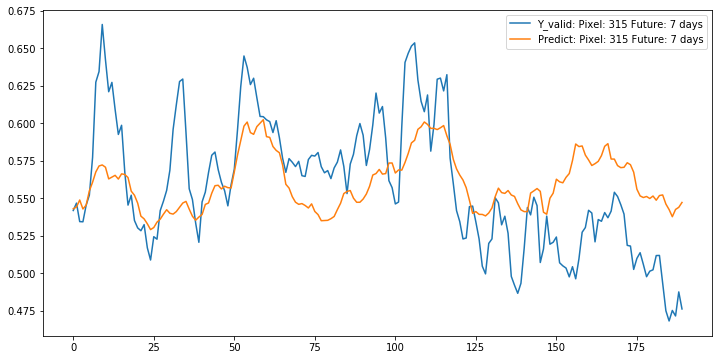

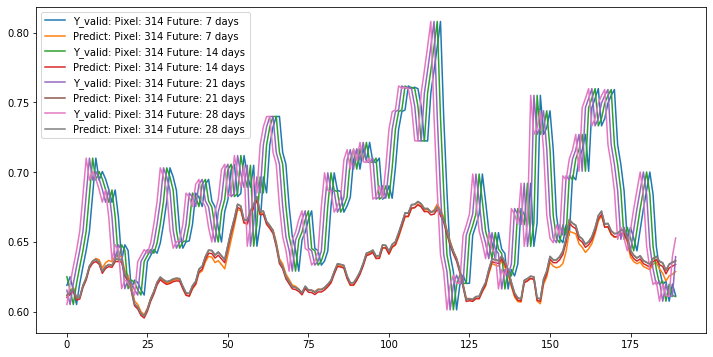

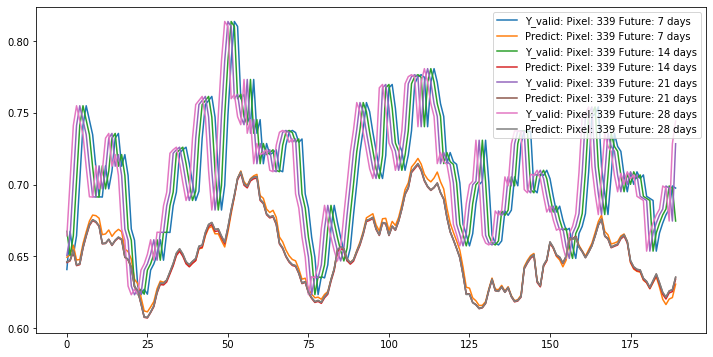

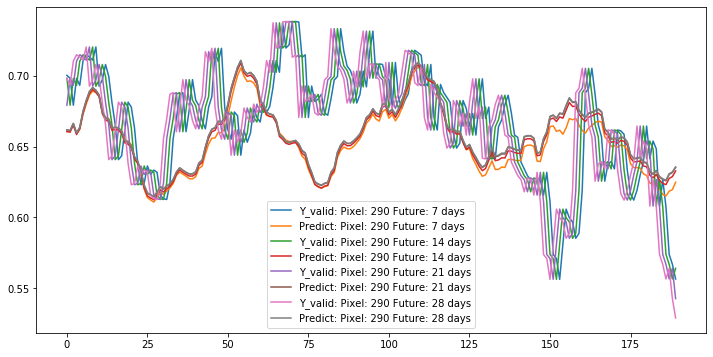

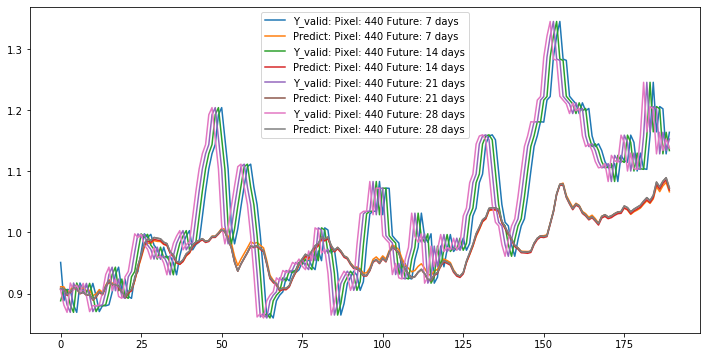

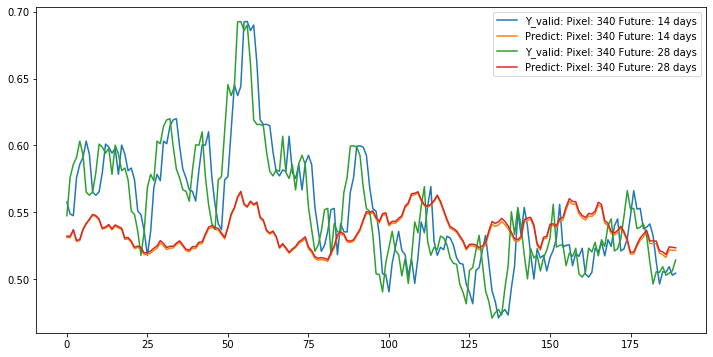

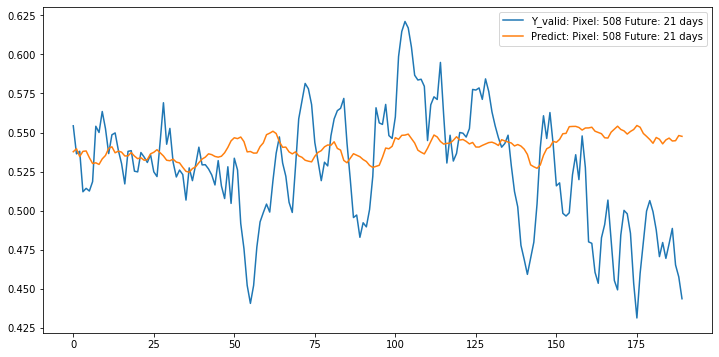

In [253]:
PlotTS([X_valid],Y_valid,model,top=5)

## EN_DEC LSTM Attention

In [254]:
# Sometimes helpful to implement own softmax activation function to
# better manage calculations along specific axes.
def softmax_activation(x):
    e = K.exp(x - K.max(x, axis=1, keepdims=True))
    s = K.sum(e, axis=1, keepdims=True)
    return e / s

In [255]:
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100
X = LSTM(units,return_sequences=True)(TimeDist)
X = Reshape((time_step, units))(X)
print()
h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

outputList = list()
for t in range(Y_train.shape[1] + 1):
    #build output for a single timestep
    h_prev_repeat = RepeatVector(time_step)(h_prev)
    joined = Concatenate(axis=-1)([X, h_prev_repeat])
    joined = Dense(int(joined.shape[2]), kernel_initializer = 'glorot_uniform', activation="tanh", name=f'attention_mid_dense_'+str(t))(joined)
    e_vals = Dense(1, kernel_initializer = 'glorot_uniform', activation='linear',  name=f'attention_final_dense_'+str(t))(joined)
    alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    #alphas = Activation('softmax', name=f'attention_softmax_'+str(t))(e_vals)
    attentions = Dot(axes=1)([alphas, X])
    #save states from previous batch 
    h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    
    if (t>0):
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='EN_DEC_LSTM_ATTENTION')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)



(None, 52, 25, 25, 1)

stack:  (None, 4, 625)
Model: "EN_DEC_LSTM_ATTENTION"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_98 (InputLayer)           [(None, 52, 25, 25,  0                                            
__________________________________________________________________________________________________
time_distributed_97 (TimeDistri (None, 52, 625)      0           input_98[0][0]                   
__________________________________________________________________________________________________
lstm_117 (LSTM)                 (None, 52, 100)      290400      time_distributed_97[0][0]        
__________________________________________________________________________________________________
h_start (InputLayer)            [(None, 100)]        0                                            
________________________________

In [256]:
h_start = np.zeros((X_train.shape[0], units*factor))
c_start = np.zeros((X_train.shape[0], units*factor))
h_startv = np.zeros((X_valid.shape[0], units*factor))
c_startv = np.zeros((X_valid.shape[0], units*factor))

EPOCHS = 5

earlystop_callback = tf.keras.callbacks.EarlyStopping(monitor="val_loss",
    min_delta=0,
    patience=EPOCHS*10,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,)

logdir = os.path.join("./logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_cbk = tf.keras.callbacks.TensorBoard(log_dir=logdir)

modelfilename = checkpoint_filepath + '_'+\
                    datetime.datetime.now().strftime("%Y%m%d-%H%M%S")\
                    + "_model.hdf5"

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    modelfilename,
    save_weights_only=False,
    monitor='val_loss',#'val_accuracy',
    mode='min',
    verbose=1,
    period = 1,
    save_best_only=True)


model.summary()



model_history = model.fit(x=[X_train,h_start, c_start],y=Y_train, 
                             validation_data=([X_valid,h_startv, c_startv], Y_valid),
                             epochs=500, 
                             batch_size=21,
                             shuffle=True,
                             callbacks=[tensorboard_cbk,
                             #hp.KerasCallback(logdir, hparams),
                             earlystop_callback,
                             model_checkpoint_callback
                                       ])

valid_loss, valid_acc = model.evaluate([X_valid,h_startv, c_startv], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

Model: "EN_DEC_LSTM_ATTENTION"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_98 (InputLayer)           [(None, 52, 25, 25,  0                                            
__________________________________________________________________________________________________
time_distributed_97 (TimeDistri (None, 52, 625)      0           input_98[0][0]                   
__________________________________________________________________________________________________
lstm_117 (LSTM)                 (None, 52, 100)      290400      time_distributed_97[0][0]        
__________________________________________________________________________________________________
h_start (InputLayer)            [(None, 100)]        0                                            
______________________________________________________________________________

Epoch 1/500
567/573 [============================>.] - ETA: 0s - loss: 0.0519 - mae: 0.0519
Epoch 00001: val_loss improved from inf to 0.03062, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-143906_model.hdf5
573/573 [==============================] - 7s 13ms/sample - loss: 0.0517 - mae: 0.0517 - val_loss: 0.0306 - val_mae: 0.0306
Epoch 2/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0141 - mae: 0.0141
Epoch 00002: val_loss improved from 0.03062 to 0.00883, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-143906_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0135 - mae: 0.0135 - val_loss: 0.0088 - val_mae: 0.0088
Epoch 3/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0059 - mae: 0.0059
Epoch 00003: val_loss improved 

525/573 [==========================>...] - ETA: 0s - loss: 0.0044 - mae: 0.0044
Epoch 00023: val_loss did not improve from 0.00670
573/573 [==============================] - 1s 1ms/sample - loss: 0.0044 - mae: 0.0044 - val_loss: 0.0068 - val_mae: 0.0068
Epoch 24/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0043 - mae: 0.0043
Epoch 00024: val_loss improved from 0.00670 to 0.00659, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-143906_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0043 - mae: 0.0043 - val_loss: 0.0066 - val_mae: 0.0066
Epoch 25/500
567/573 [============================>.] - ETA: 0s - loss: 0.0042 - mae: 0.0042
Epoch 00025: val_loss improved from 0.00659 to 0.00658, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-14390

Epoch 50/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0040 - mae: 0.0040
Epoch 00050: val_loss did not improve from 0.00632
573/573 [==============================] - 1s 1ms/sample - loss: 0.0040 - mae: 0.0040 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 51/500
567/573 [============================>.] - ETA: 0s - loss: 0.0039 - mae: 0.0039
Epoch 00051: val_loss did not improve from 0.00632
573/573 [==============================] - 1s 1ms/sample - loss: 0.0039 - mae: 0.0039 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 52/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0039 - mae: 0.0039
Epoch 00052: val_loss did not improve from 0.00632
573/573 [==============================] - 1s 1ms/sample - loss: 0.0039 - mae: 0.0039 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 53/500
567/573 [============================>.] - ETA: 0s - loss: 0.0039 - mae: 0.0039
Epoch 00053: val_loss did not improve from 0.00632
573/573 [==============================] - 1s 1ms/sampl

Epoch 79/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00079: val_loss did not improve from 0.00623
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 80/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00080: val_loss did not improve from 0.00623
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 81/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00081: val_loss did not improve from 0.00623
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 82/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00082: val_loss did not improve from 0.00623
573/573 [==============================] - 1s 1ms/sampl

Epoch 108/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00108: val_loss did not improve from 0.00617
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 109/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0038 - mae: 0.0038
Epoch 00109: val_loss did not improve from 0.00617
573/573 [==============================] - 1s 1ms/sample - loss: 0.0038 - mae: 0.0038 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 110/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00110: val_loss did not improve from 0.00617
573/573 [==============================] - 1s 1ms/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0062 - val_mae: 0.0062
Epoch 111/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00111: val_loss did not improve from 0.00617
573/573 [==============================] - 1s 1ms/s

567/573 [============================>.] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00135: val_loss improved from 0.00594 to 0.00592, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-143906_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 136/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00136: val_loss did not improve from 0.00592
573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0060 - val_mae: 0.0060
Epoch 137/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0036 - mae: 0.0036
Epoch 00137: val_loss did not improve from 0.00592
573/573 [==============================] - 1s 1ms/sample - loss: 0.0036 - mae: 0.0036 - val_loss: 0.0060 - val_mae: 0.0060
Epoch 138/500
525/573 [=============

Epoch 162/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00162: val_loss improved from 0.00559 to 0.00558, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-143906_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0056 - val_mae: 0.0056
Epoch 163/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00163: val_loss did not improve from 0.00558
573/573 [==============================] - 1s 1ms/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0058 - val_mae: 0.0058
Epoch 164/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00164: val_loss did not improve from 0.00558
573/573 [==============================] - 1s 1ms/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 165/500
525/573 

Epoch 191/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00191: val_loss did not improve from 0.00552
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0056 - val_mae: 0.0056
Epoch 192/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00192: val_loss did not improve from 0.00552
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 193/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00193: val_loss did not improve from 0.00552
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0056 - val_mae: 0.0056
Epoch 194/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00194: val_loss did not improve from 0.00552
573/573 [==============================] - 1s 1ms/s

Epoch 220/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00220: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0056 - val_mae: 0.0056
Epoch 221/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00221: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0058 - val_mae: 0.0058
Epoch 222/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00222: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0057 - val_mae: 0.0057
Epoch 223/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00223: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/s

Epoch 251/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00251: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0058 - val_mae: 0.0058
Epoch 252/500
567/573 [============================>.] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00252: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0055 - val_mae: 0.0055
Epoch 253/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00253: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0055 - val_mae: 0.0055
Epoch 254/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00254: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/s

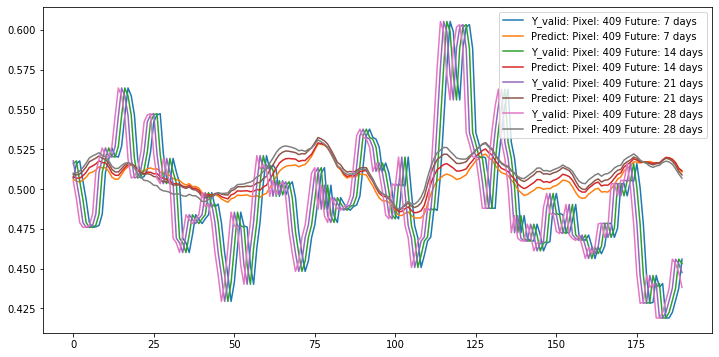

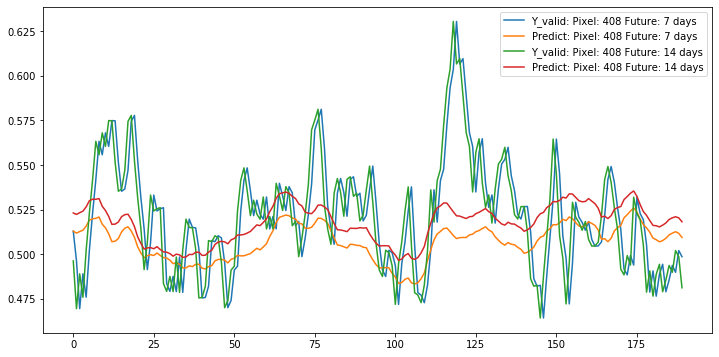

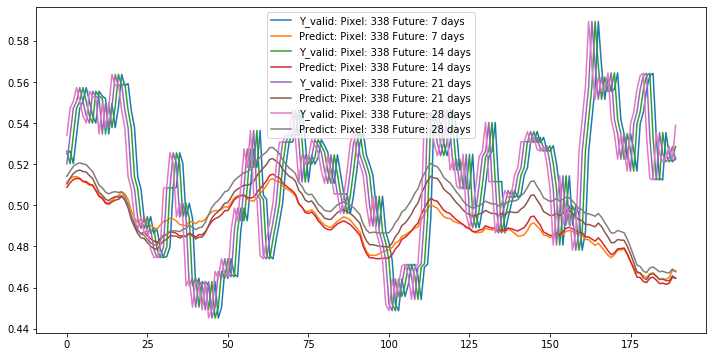

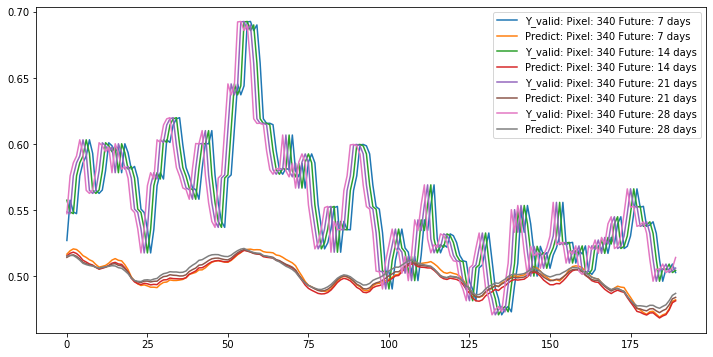

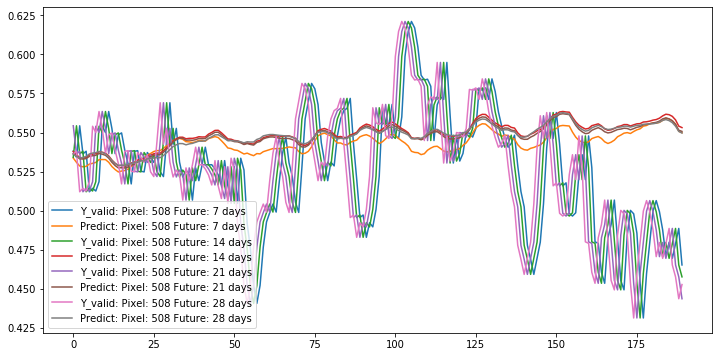

...

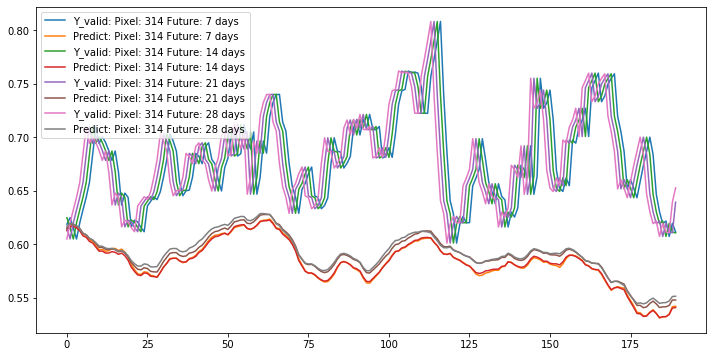

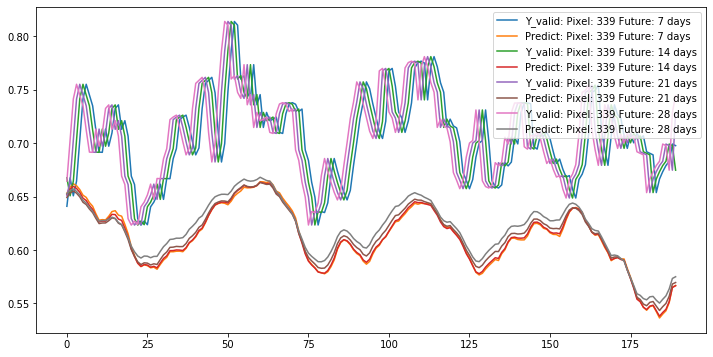

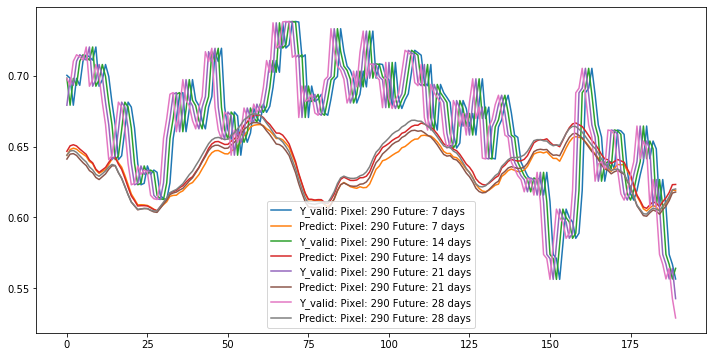

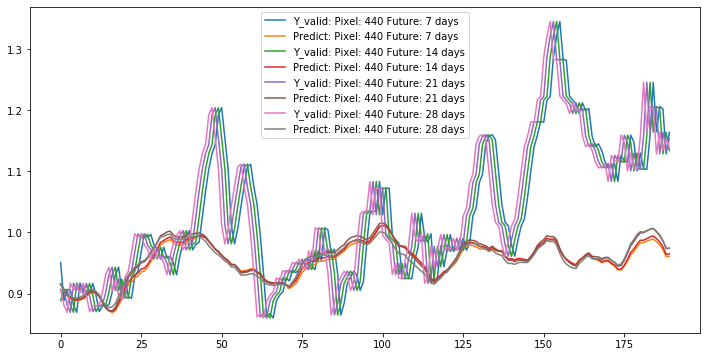

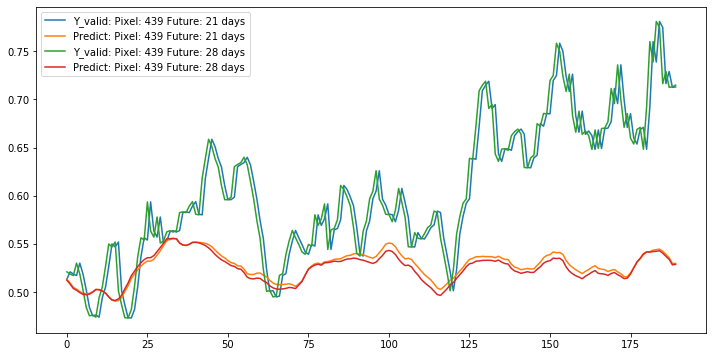

In [258]:
PlotTS([X_valid,h_startv, c_startv],Y_valid,model,top=10)

## Encoder + Decoder with LSTM for each timestep out

In [259]:
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100
factor = 1
X = LSTM(units,return_sequences=True)(TimeDist)
print(X.shape)
X = Reshape((time_step, units))(X)
print(X.shape)
h_start = Input(shape=(units*factor,), name='h_start')
print("h_start.shape:",h_start.shape)
c_start = Input(shape=(units*factor,), name='c_start')
h_prev = h_start
c_prev = c_start

outputList = list()
for t in range(Y_train.shape[1]+1):
    h_prev, _, c_prev = LSTM(units*factor, return_state=True,name=f'layer_2_LSTM_{t}')(X, initial_state=[h_prev, c_prev])
    if t > 0:
        out = Dense(Y_train.shape[2],activation='linear', name=f'dense_output_{t}')(h_prev)
        outputList.append(out)
outputs = tf.stack(outputList,1)
print(outputs.shape)
model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='EN_DEC_LSTM')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)

(None, 52, 25, 25, 1)
(None, 52, 100)
(None, 52, 100)
h_start.shape: (None, 100)
(None, 4, 625)
Model: "EN_DEC_LSTM"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_99 (InputLayer)           [(None, 52, 25, 25,  0                                            
__________________________________________________________________________________________________
time_distributed_98 (TimeDistri (None, 52, 625)      0           input_99[0][0]                   
__________________________________________________________________________________________________
lstm_118 (LSTM)                 (None, 52, 100)      290400      time_distributed_98[0][0]        
__________________________________________________________________________________________________
reshape_111 (Reshape)           (None, 52, 100)      0           lstm_118[0][0]            

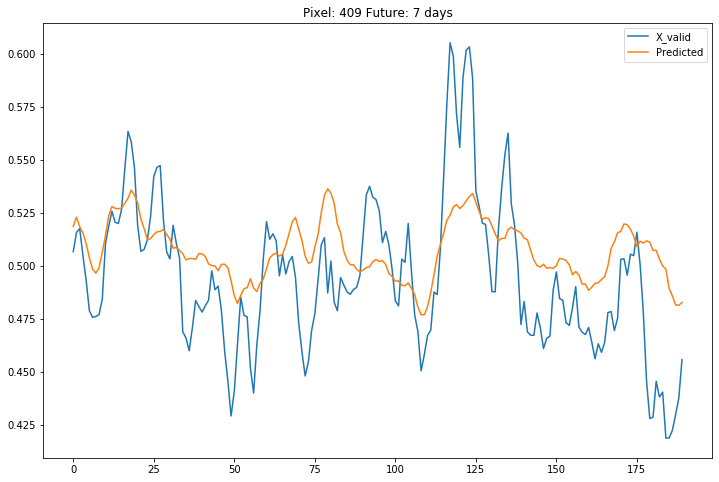

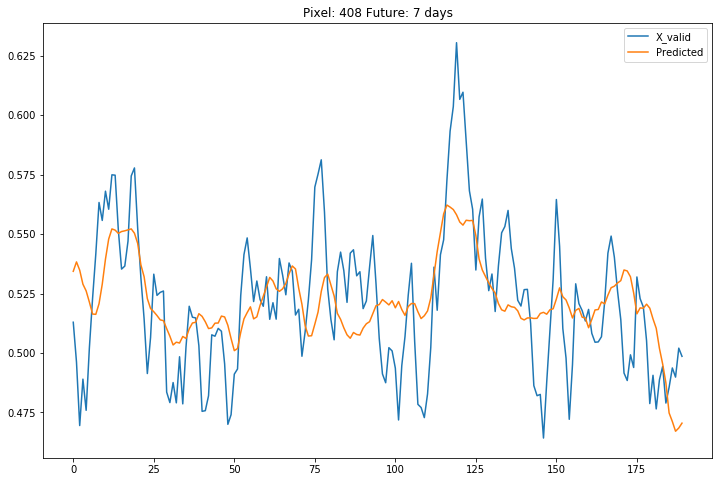

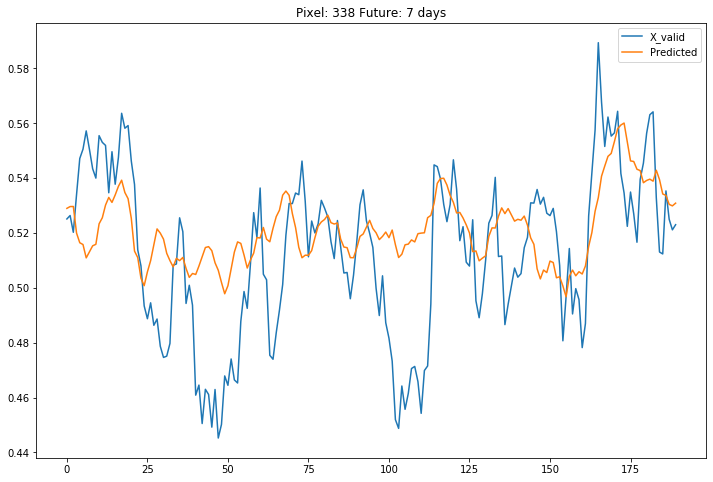

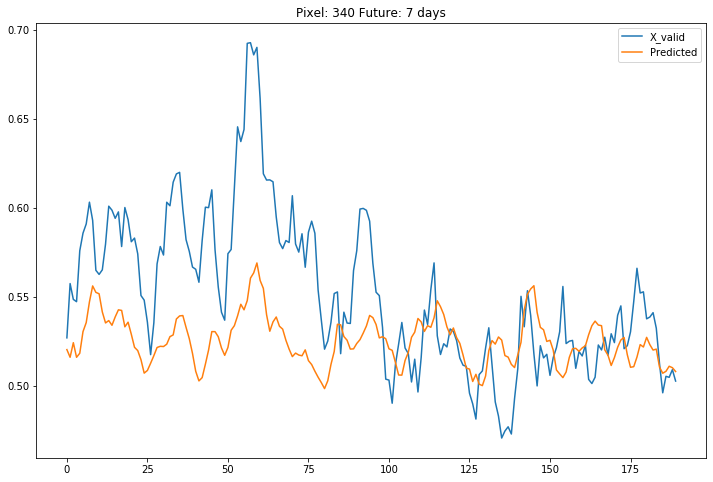

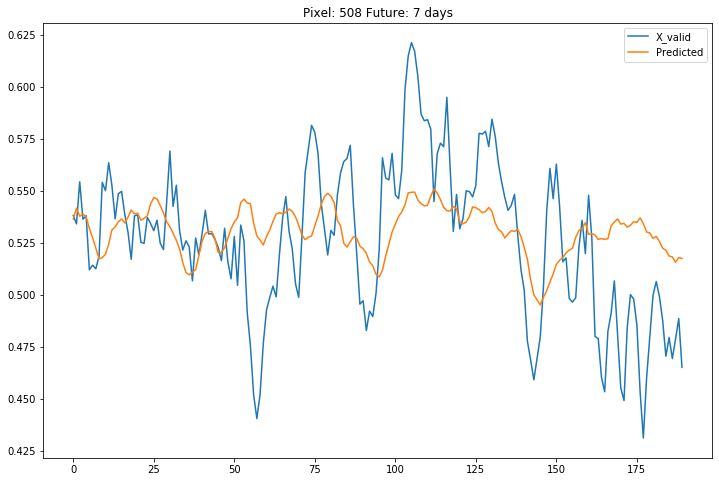

...

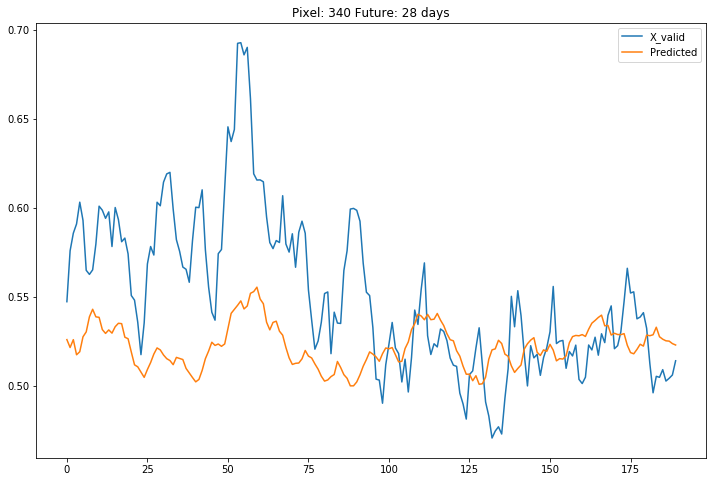

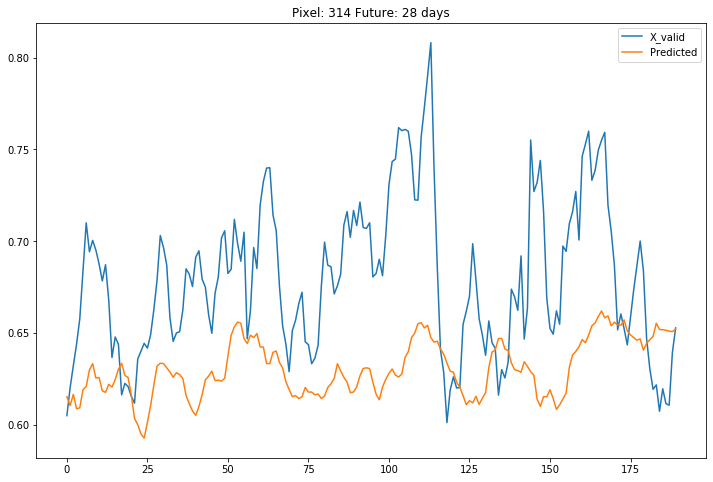

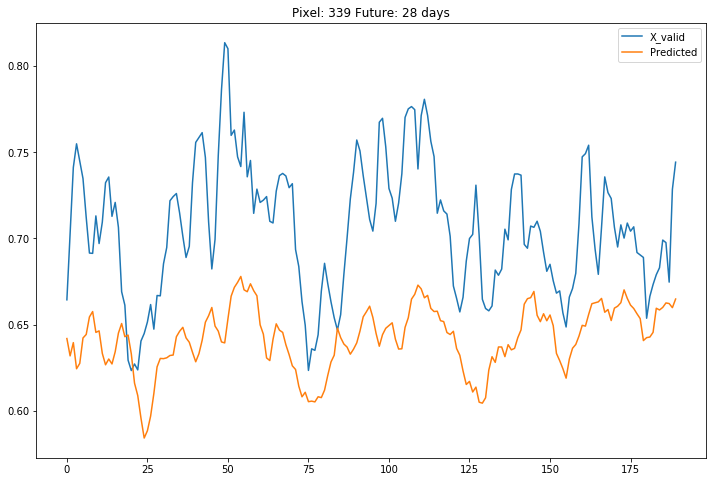

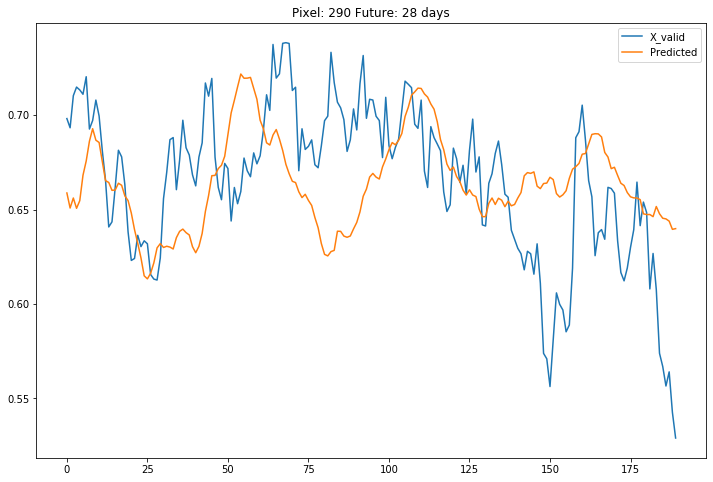

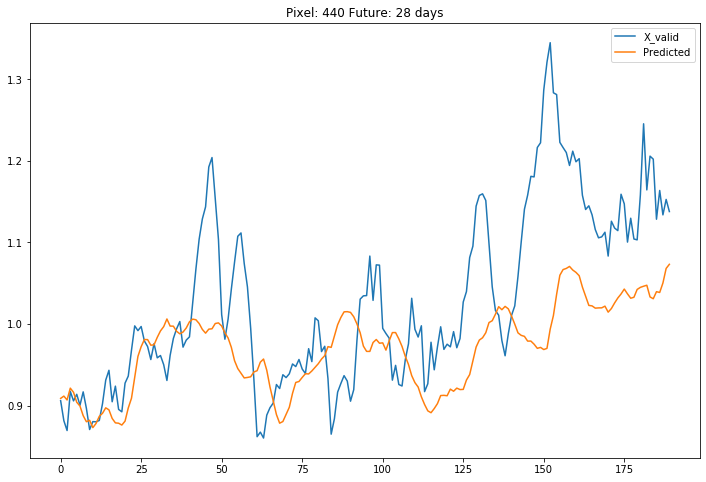

In [87]:
Predict = model.predict([X_valid,h_startv, c_startv])

for ts,listOfTopTen in enumerate(np.argsort(Y_valid)[:,:,-10:][0]):
    #print(ts,listOfTopTen)
    for i in listOfTopTen:
        pd.DataFrame(np.transpose(np.vstack([Y_valid[:,ts,i],Predict[:,ts,i]])),
                     columns=["X_valid","Predicted"]).plot(figsize=(12,8),
                                                           title="Pixel: "+str(i)+" Future: " + str(int((ts+1)*7)) + " days")

## LSTM + Attention on LSTM units frequency

In [216]:
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100
X = LSTM(units,return_sequences=True)(TimeDist)
X = Reshape((time_step, units))(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start

print("X.shape",X.shape)
print("h_prev.shape",h_prev.shape)

timeDist = Permute([2, 1])(X) #transpose for FFT. FFT library treats the last dimension as time
print('timeDist.shape',timeDist.shape)
fftLayer = Lambda(lambda x : tf.math.abs(tf.signal.rfft(x)))(timeDist) ## transform to frequency domain with TF
print('fftLayer.shape',fftLayer.shape)
fftLayer  = Permute([2, 1], name="fft_out")(fftLayer)#transpose back for the following shape
print('fftLayer.shape',fftLayer.shape) #Hc_i

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    #build output for a single timestep
    #h_prev_repeat = RepeatVector(time_step)(h_prev)
    #h_prev_repeat = RepeatVector(units)(h_prev)
    #print("h_prev_repeat.shape",h_prev_repeat.shape)
    #joined = Concatenate(axis=-1)([X, h_prev_repeat])
    joined = Dense(units, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_mid_dense_'+str(t))(X) #Wa
    print("joined.shape",joined.shape)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([fftLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    e_vals = Dense(1, 
                   kernel_initializer = 'glorot_uniform', 
                   activation='linear',  
                   name=f'attention_final_dense_'+str(t))(scoringfunc)
    print("e_vals",e_vals.shape)
    alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    #alphas = Activation('sigmoid', name=f'attention_softmax_'+str(t))(e_vals)
    print("alphas",alphas.shape)
    attentions = Dot(axes=1)([alphas, fftLayer])
    print("attentions",attentions.shape)
    #save states from previous batch 
    h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    print("h_prev.shape",h_prev.shape)
    if (t>0):
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_UNITs')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


(None, 52, 25, 25, 1)
X.shape (None, 52, 100)
h_prev.shape (None, 100)
timeDist.shape (None, 100, 52)
fftLayer.shape (None, 100, 27)
fftLayer.shape (None, 27, 100)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
h_prev.shape (None, 100)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
h_prev.shape (None, 100)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
h_prev.shape (None, 100)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
h_prev.shape (None, 100)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (N

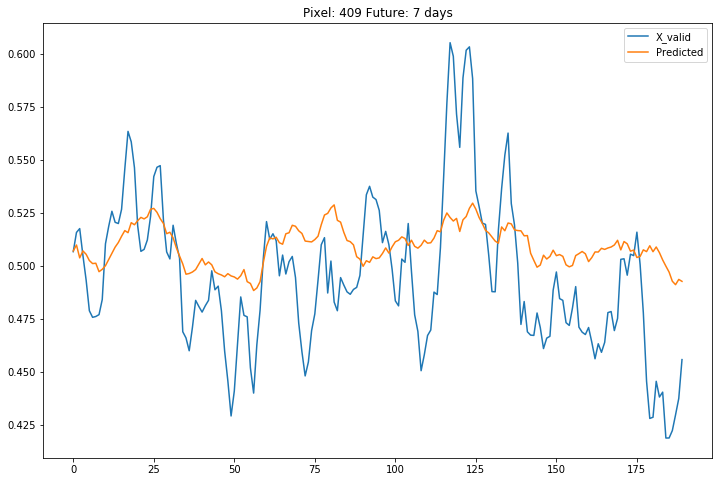

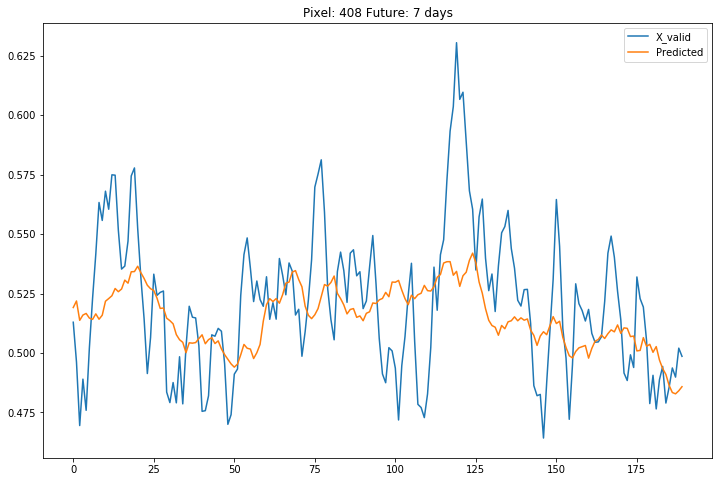

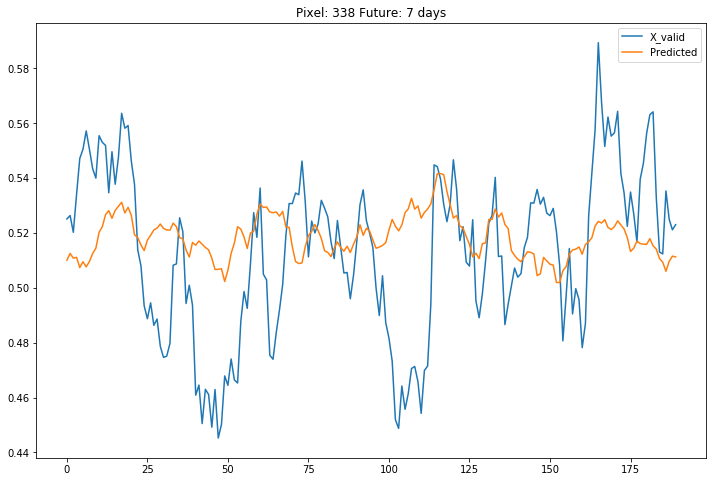

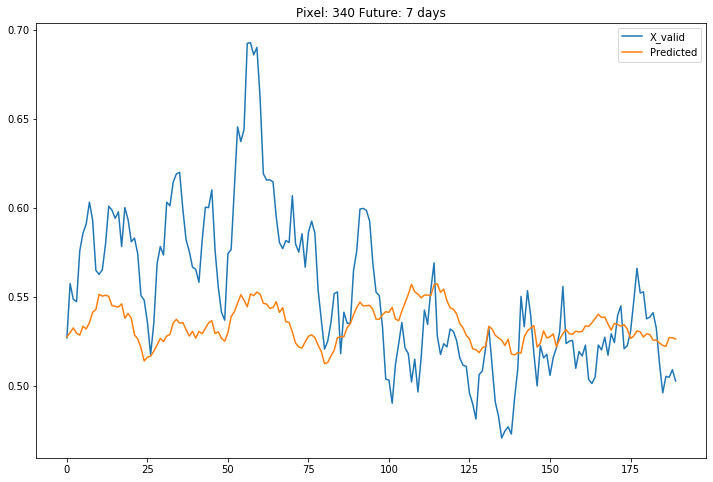

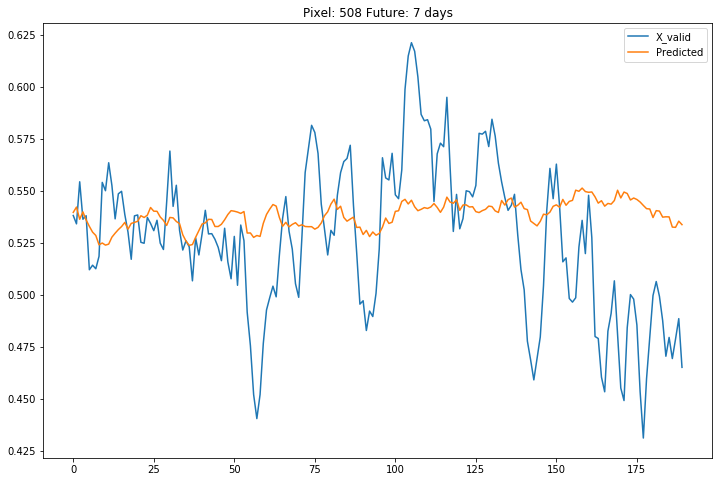

...

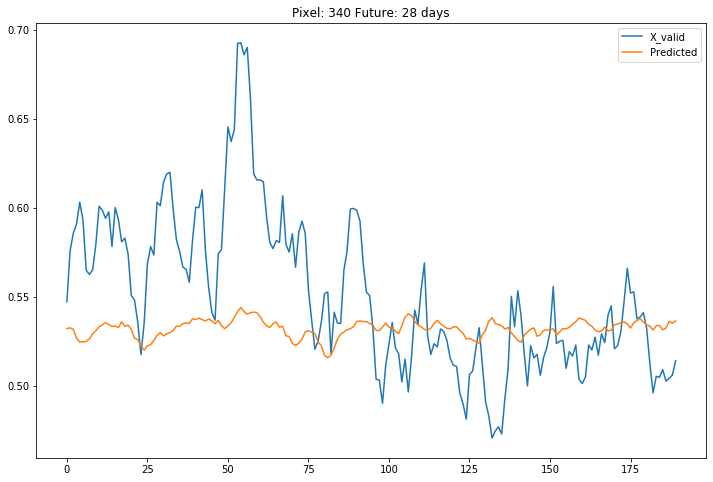

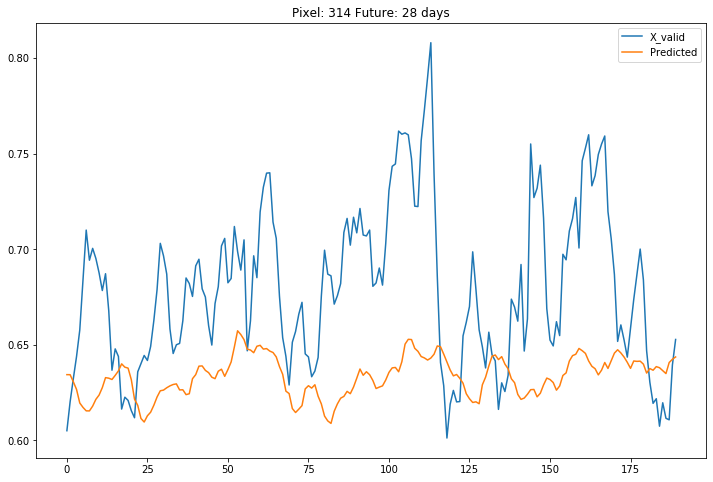

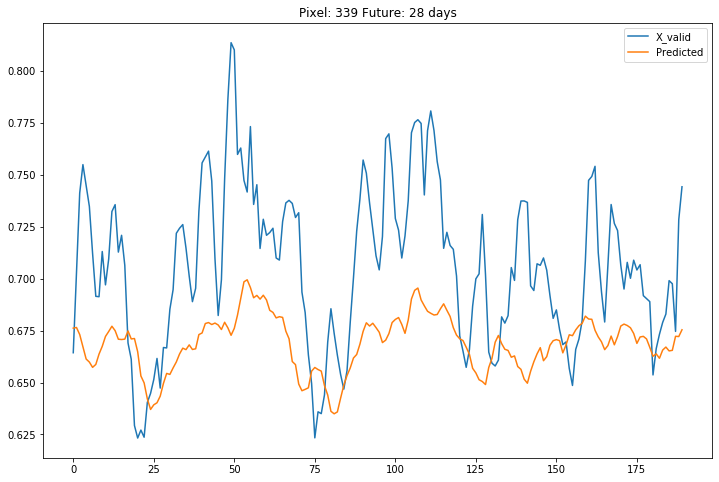

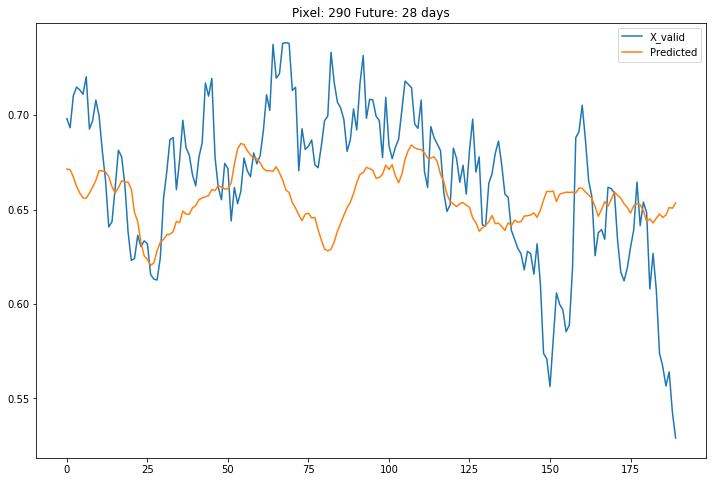

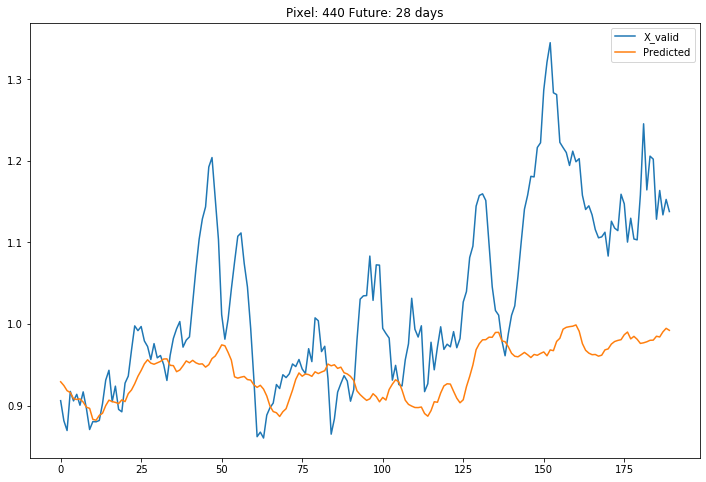

In [164]:
Predict = model.predict([X_valid,h_startv, c_startv])

for ts,listOfTopTen in enumerate(np.argsort(Y_valid)[:,:,-10:][0]):
    #print(ts,listOfTopTen)
    for i in listOfTopTen:
        pd.DataFrame(np.transpose(np.vstack([Y_valid[:,ts,i],Predict[:,ts,i]])),
                     columns=["X_valid","Predicted"]).plot(figsize=(12,8),
                                                           title="Pixel: "+str(i)+" Future: " + str(int((ts+1)*7)) + " days")

In [260]:
serie_size, time_step, n_features_row, n_features_column, no_channel = X_train.shape

inputs = Input(shape=(time_step,n_features_row, n_features_column, no_channel))
TimeDist = TimeDistributed(Flatten())(inputs)
print(inputs.shape)
units = 100
X = LSTM(units,return_sequences=True)(TimeDist)
X = Reshape((time_step, units))(X)

h_start = Input(shape=(units,), name='h_start')
c_start = Input(shape=(units,), name='c_start')
h_prev = h_start
c_prev = c_start


timeDist = Permute([2, 1])(X) #transpose for FFT. FFT library treats the last dimension as time
fftLayer = Lambda(lambda x : tf.math.abs(tf.signal.rfft(x)))(timeDist) ## transform to frequency domain with TF
fftLayer  = Permute([2, 1], name="fft_out")(fftLayer)#transpose back for the following shape

outputList = list()
for t in range(Y_train.shape[1] + 1): #range(1):
    joined = Dense(units, 
                   kernel_initializer = 'glorot_uniform', 
                   activation="tanh", 
                   name=f'attention_W_dense_'+str(t))(X) #Wa
    print("joined.shape",joined.shape)
    joined = Permute([2,1])(joined)
    print("joined.shape",joined.shape)
    scoringfunc = Lambda(lambda x: K.batch_dot(x[0],x[1]))([fftLayer,joined])
    print("scoringfunc.shape",scoringfunc.shape)
    e_vals = Dense(1, 
                   kernel_initializer = 'glorot_uniform', 
                   activation='linear',  
                   name=f'attention_Q_dense_'+str(t))(scoringfunc)
    print("e_vals",e_vals.shape)
    #alphas = Activation(softmax_activation, name=f'attention_softmax_'+str(t))(e_vals)
    alphas = Activation('sigmoid', name=f'attention_softmax_'+str(t))(e_vals)
    print("alphas",alphas.shape)
    attentions = Dot(axes=1)([alphas, fftLayer])
    print("attentions",attentions.shape)
    #save states from previous batch 
    #h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(attentions, initial_state=[h_prev, c_prev])
    #print("h_prev.shape",h_prev.shape)
    if (t>0):
        print("X",X[:,-1,:].shape)
        out1 = Flatten()(Dense(units,activation='linear', name='dense_Vt_'+str(t))(attentions))
        out2 = Dense(units,activation='linear', name='dense_Ht_'+str(t))(X[:,-1,:])
        out = Concatenate(axis=1)([out1,out2])
        out = Reshape((1,out.shape[-1]))(out)
        h_prev, _, c_prev = LSTM(units, return_state=True,name='layer_2_LSTM_'+str(t))(out, initial_state=[h_prev, c_prev])
        out = Dense(Y_train.shape[2],activation='linear', name='dense_output_'+str(t))(h_prev)
        out = Flatten()(out)
        print("out: ",out.shape)
        outputList.append(out)
        
outputs = tf.stack(outputList,axis=1)
print("stack: ",outputs.shape)

model = Model(inputs=[inputs, h_start, c_start], outputs=outputs, name='LSTM_ATTENTION_Freq')
model.summary()

adam = optimizers.Adam(lr)
model.compile(loss='mean_absolute_error',
                   metrics=['mae'], 
                   optimizer=adam)


(None, 52, 25, 25, 1)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
joined.shape (None, 52, 100)
joined.shape (None, 100, 52)
scoringfunc.shape (None, 27, 52)
e_vals (None, 27, 1)
alphas (None, 27, 1)
attentions (None, 1, 100)
X (None, 100)
out:  (None, 625)
stack:  (None, 4, 625)
Model: "LSTM_ATTENTION_Freq"
___

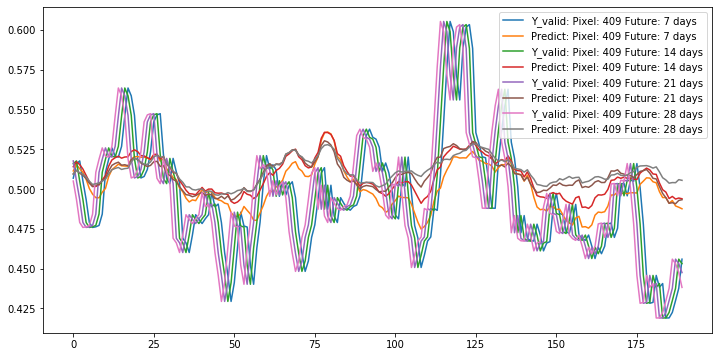

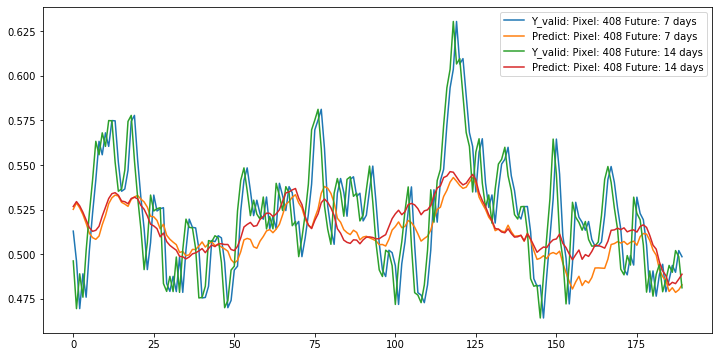

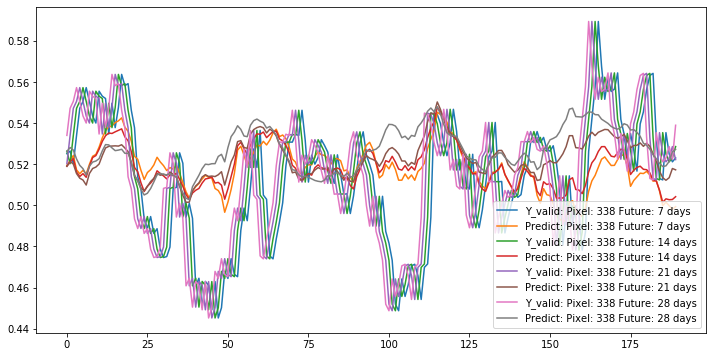

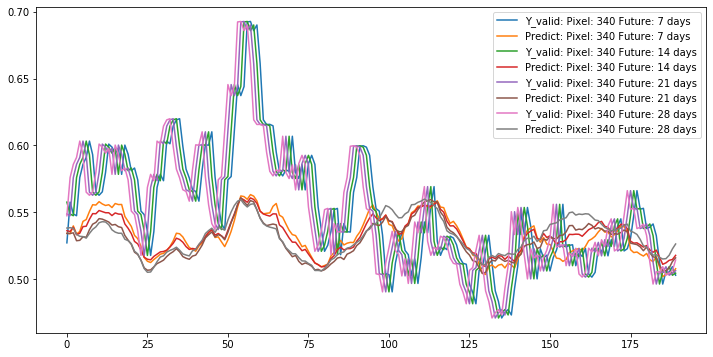

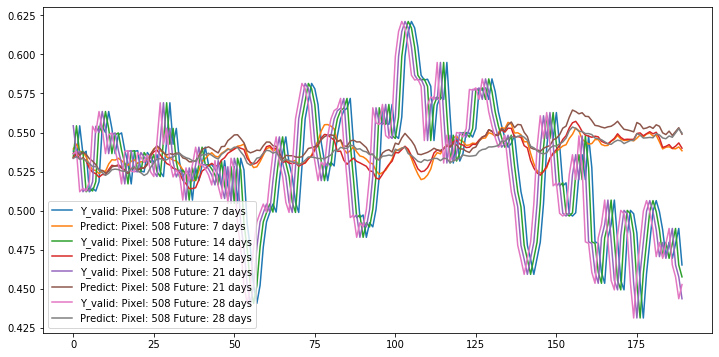

...

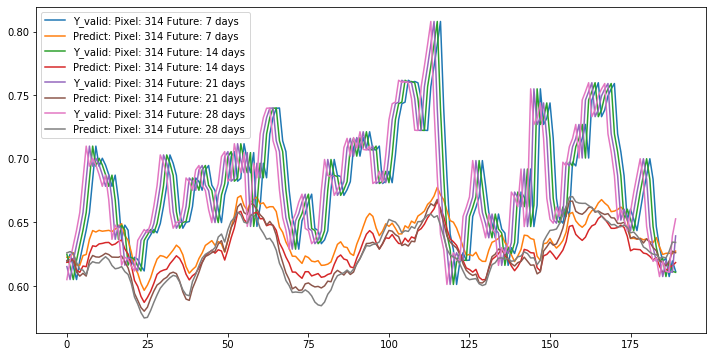

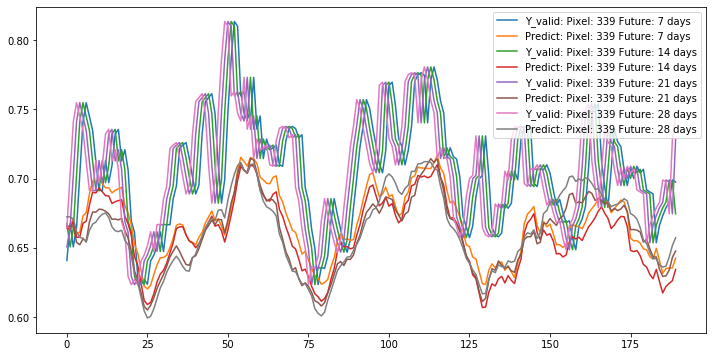

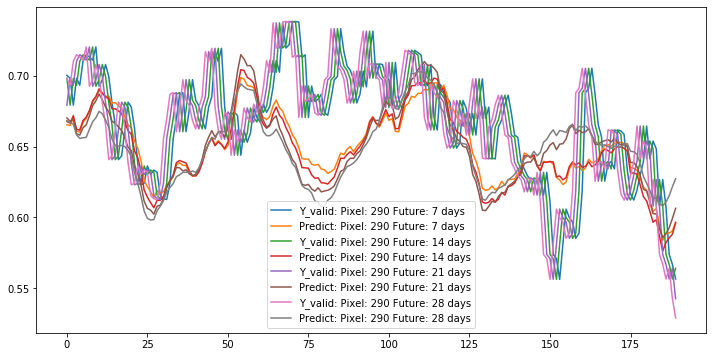

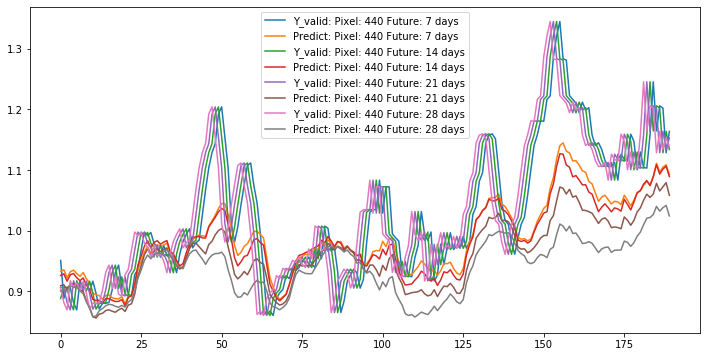

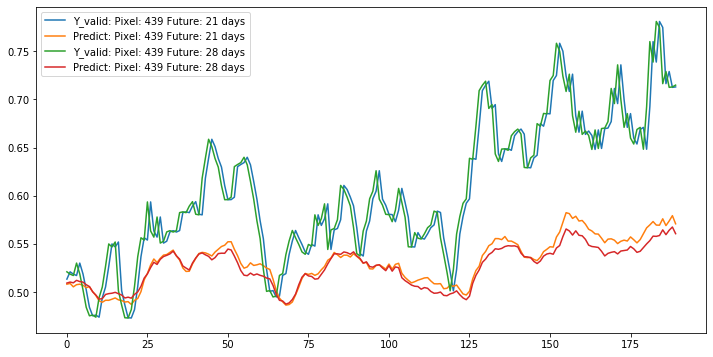

In [262]:
PlotTS([X_valid,h_startv, c_startv],Y_valid,model,top=10) 

## ---------------------> Run fit on any of the previous model here <--------------------------

In [261]:
h_start = np.zeros((X_train.shape[0], units*factor))
c_start = np.zeros((X_train.shape[0], units*factor))
h_startv = np.zeros((X_valid.shape[0], units*factor))
c_startv = np.zeros((X_valid.shape[0], units*factor))
h_startt = np.zeros((X_test.shape[0], units*factor))
c_startt = np.zeros((X_test.shape[0], units*factor))


EPOCHS = 5

earlystop_callback = tf.keras.callbacks.EarlyStopping(monitor="val_loss",
    min_delta=0,
    patience=EPOCHS*10,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,)

logdir = os.path.join("./logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_cbk = tf.keras.callbacks.TensorBoard(log_dir=logdir)

modelfilename = checkpoint_filepath + '_'+\
                    datetime.datetime.now().strftime("%Y%m%d-%H%M%S")\
                    + "_model.hdf5"

model_checkpoint_callback = tf.keras.callbacks.ModelCheckpoint(
    modelfilename,
    save_weights_only=False,
    monitor='val_loss',#'val_accuracy',
    mode='min',
    verbose=1,
    period = 1,
    save_best_only=True)


model.summary()



model_history = model.fit(x=[X_train,h_start, c_start],y=Y_train, 
                             validation_data=([X_valid,h_startv, c_startv], Y_valid),
                             epochs=500, 
                             batch_size=21,
                             shuffle=True,
                             callbacks=[tensorboard_cbk,
                             #hp.KerasCallback(logdir, hparams),
                             earlystop_callback,
                             model_checkpoint_callback
                                       ])

valid_loss, valid_acc = model.evaluate([X_valid,h_startv, c_startv], Y_valid, verbose=2) # 5/2020 nt: use validation set
print ("valid_accuracy_MAE=%s, valid_loss=%s" % (valid_acc, valid_loss))

test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

Model: "LSTM_ATTENTION_Freq"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_100 (InputLayer)          [(None, 52, 25, 25,  0                                            
__________________________________________________________________________________________________
time_distributed_99 (TimeDistri (None, 52, 625)      0           input_100[0][0]                  
__________________________________________________________________________________________________
lstm_119 (LSTM)                 (None, 52, 100)      290400      time_distributed_99[0][0]        
__________________________________________________________________________________________________
reshape_112 (Reshape)           (None, 52, 100)      0           lstm_119[0][0]                   
________________________________________________________________________________

Epoch 1/500
567/573 [============================>.] - ETA: 0s - loss: 0.0604 - mae: 0.0604
Epoch 00001: val_loss improved from inf to 0.03223, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-144429_model.hdf5
573/573 [==============================] - 7s 11ms/sample - loss: 0.0601 - mae: 0.0601 - val_loss: 0.0322 - val_mae: 0.0322
Epoch 2/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0172 - mae: 0.0172
Epoch 00002: val_loss improved from 0.03223 to 0.00957, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-144429_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0164 - mae: 0.0164 - val_loss: 0.0096 - val_mae: 0.0096
Epoch 3/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0061 - mae: 0.0061
Epoch 00003: val_loss improved 

525/573 [==========================>...] - ETA: 0s - loss: 0.0049 - mae: 0.0049
Epoch 00021: val_loss did not improve from 0.00709
573/573 [==============================] - 1s 1ms/sample - loss: 0.0049 - mae: 0.0049 - val_loss: 0.0071 - val_mae: 0.0071
Epoch 22/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0050 - mae: 0.0050
Epoch 00022: val_loss improved from 0.00709 to 0.00705, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-144429_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0050 - mae: 0.0050 - val_loss: 0.0071 - val_mae: 0.0071
Epoch 23/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0049 - mae: 0.0049
Epoch 00023: val_loss improved from 0.00705 to 0.00704, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-14442

Epoch 47/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0042 - mae: 0.0042
Epoch 00047: val_loss did not improve from 0.00646
573/573 [==============================] - 1s 1ms/sample - loss: 0.0042 - mae: 0.0042 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 48/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0042 - mae: 0.0042
Epoch 00048: val_loss did not improve from 0.00646
573/573 [==============================] - 1s 1ms/sample - loss: 0.0042 - mae: 0.0042 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 49/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0042 - mae: 0.0042
Epoch 00049: val_loss did not improve from 0.00646
573/573 [==============================] - 1s 1ms/sample - loss: 0.0042 - mae: 0.0042 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 50/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0042 - mae: 0.0042
Epoch 00050: val_loss did not improve from 0.00646
573/573 [==============================] - 1s 1ms/sampl

Epoch 75/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0040 - mae: 0.0040
Epoch 00075: val_loss did not improve from 0.00636
573/573 [==============================] - 1s 1ms/sample - loss: 0.0040 - mae: 0.0040 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 76/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0040 - mae: 0.0040
Epoch 00076: val_loss did not improve from 0.00636
573/573 [==============================] - 1s 1ms/sample - loss: 0.0040 - mae: 0.0040 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 77/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0039 - mae: 0.0039
Epoch 00077: val_loss did not improve from 0.00636
573/573 [==============================] - 1s 1ms/sample - loss: 0.0039 - mae: 0.0039 - val_loss: 0.0065 - val_mae: 0.0065
Epoch 78/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0039 - mae: 0.0039
Epoch 00078: val_loss did not improve from 0.00636
573/573 [==============================] - 1s 1ms/sampl

Epoch 104/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00104: val_loss did not improve from 0.00624
573/573 [==============================] - 1s 1ms/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 105/500
546/573 [===========================>..] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00105: val_loss did not improve from 0.00624
573/573 [==============================] - 1s 1ms/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0064 - val_mae: 0.0064
Epoch 106/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00106: val_loss did not improve from 0.00624
573/573 [==============================] - 1s 1ms/sample - loss: 0.0037 - mae: 0.0037 - val_loss: 0.0063 - val_mae: 0.0063
Epoch 107/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0037 - mae: 0.0037
Epoch 00107: val_loss did not improve from 0.00624
573/573 [==============================] - 1s 1ms/s

525/573 [==========================>...] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00131: val_loss improved from 0.00600 to 0.00593, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-144429_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0035 - mae: 0.0035 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 132/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00132: val_loss improved from 0.00593 to 0.00590, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-144429_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0035 - mae: 0.0035 - val_loss: 0.0059 - val_mae: 0.0059
Epoch 133/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0035 - mae: 0.0035
Epoch 00133: val_loss improved from 

573/573 [==============================] - 1s 1ms/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0054 - val_mae: 0.0054
Epoch 155/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0034 - mae: 0.0034
Epoch 00155: val_loss did not improve from 0.00539
573/573 [==============================] - 1s 1ms/sample - loss: 0.0034 - mae: 0.0034 - val_loss: 0.0055 - val_mae: 0.0055
Epoch 156/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00156: val_loss improved from 0.00539 to 0.00534, saving model to /home/zhimin90/DePaul/CSC695/Github/CSC695-Masters-Research-on-Neural-Network-Time-Series-Attention-Models/Asset/checkpoints/_20200726-144429_model.hdf5
573/573 [==============================] - 1s 1ms/sample - loss: 0.0033 - mae: 0.0033 - val_loss: 0.0053 - val_mae: 0.0053
Epoch 157/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0033 - mae: 0.0033
Epoch 00157: val_loss did not improve from 0.00534
573/573 [=============

Epoch 182/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00182: val_loss did not improve from 0.00511
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0051 - val_mae: 0.0051
Epoch 183/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00183: val_loss did not improve from 0.00511
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 184/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00184: val_loss did not improve from 0.00511
573/573 [==============================] - 1s 1ms/sample - loss: 0.0032 - mae: 0.0032 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 185/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0032 - mae: 0.0032
Epoch 00185: val_loss did not improve from 0.00511
573/573 [==============================] - 1s 1ms/s

Epoch 212/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00212: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 213/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00213: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0053 - val_mae: 0.0053
Epoch 214/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00214: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/sample - loss: 0.0031 - mae: 0.0031 - val_loss: 0.0052 - val_mae: 0.0052
Epoch 215/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0031 - mae: 0.0031
Epoch 00215: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/s

Epoch 243/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00243: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/sample - loss: 0.0029 - mae: 0.0029 - val_loss: 0.0053 - val_mae: 0.0053
Epoch 244/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0029 - mae: 0.0029
Epoch 00244: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/sample - loss: 0.0029 - mae: 0.0029 - val_loss: 0.0053 - val_mae: 0.0053
Epoch 245/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0028 - mae: 0.0028
Epoch 00245: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/sample - loss: 0.0028 - mae: 0.0028 - val_loss: 0.0053 - val_mae: 0.0053
Epoch 246/500
525/573 [==========================>...] - ETA: 0s - loss: 0.0028 - mae: 0.0028
Epoch 00246: val_loss did not improve from 0.00509
573/573 [==============================] - 1s 1ms/s

## LSTM

In [169]:
test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

190/190 - 0s - loss: 0.0080 - mae: 0.0080
test_accuracy_MAE=0.008018181, test_loss=0.008018180659334911


## EN_DEC LSTM + Attention on frequency

In [263]:
test_loss, test_acc = model.evaluate([X_test,h_startv, c_startv], Y_test, verbose=2) # 5/2020 nt: use validation set
print ("test_accuracy_MAE=%s, test_loss=%s" % (test_acc, test_loss))

190/190 - 0s - loss: 0.0080 - mae: 0.0080
test_accuracy_MAE=0.007998274, test_loss=0.007998273090312355


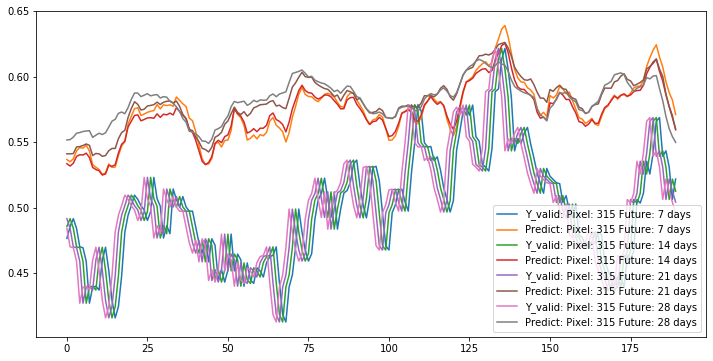

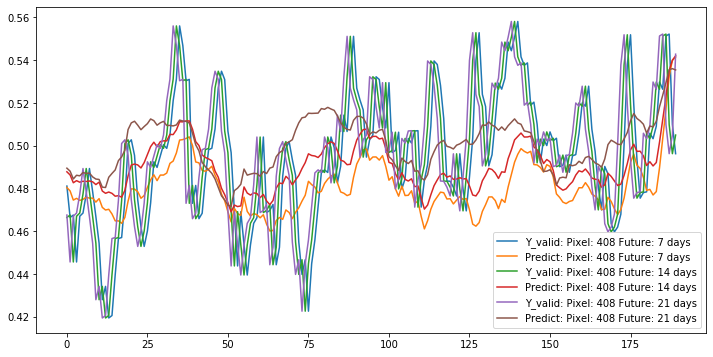

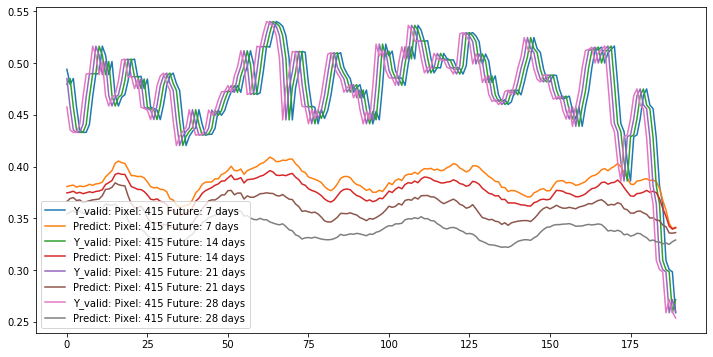

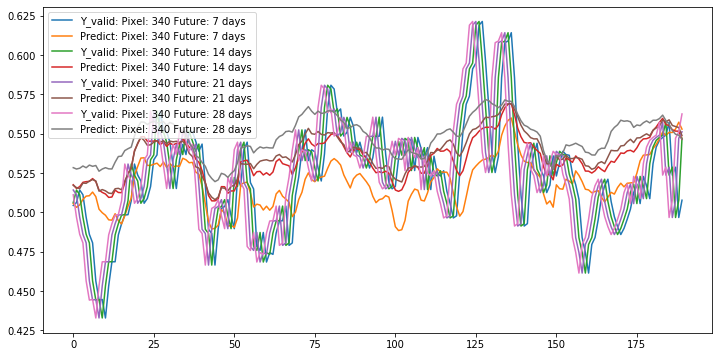

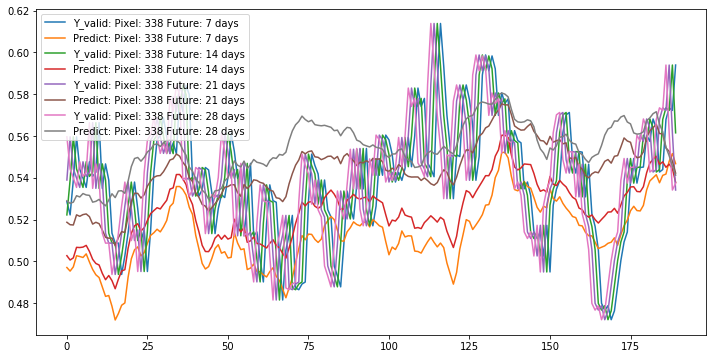

...

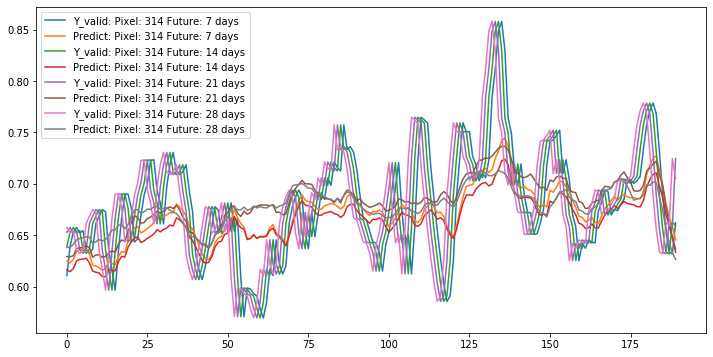

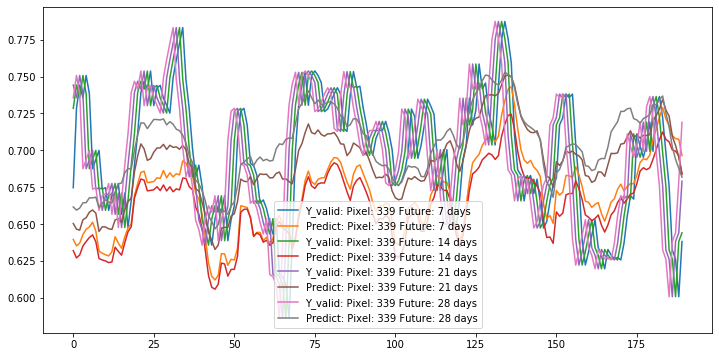

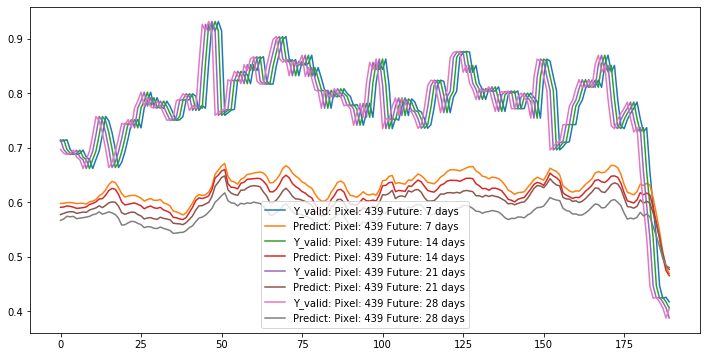

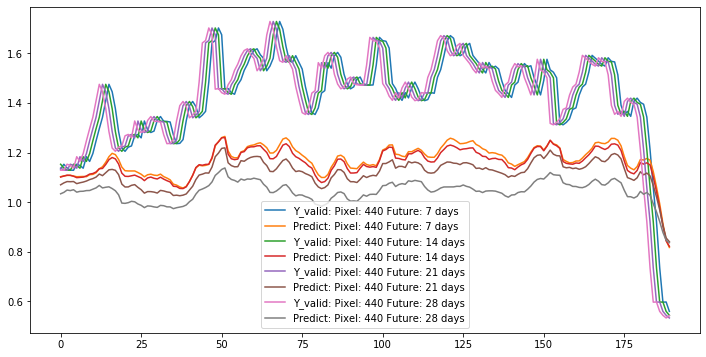

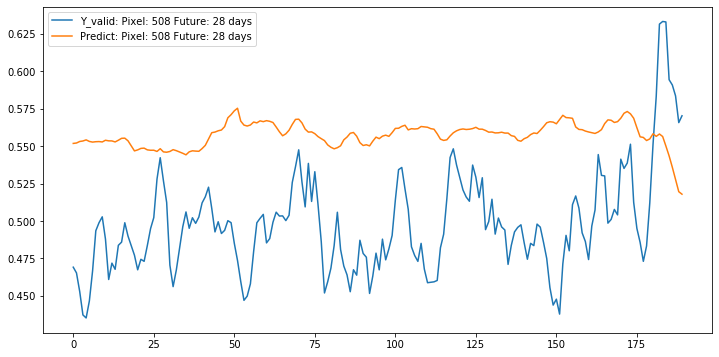

In [264]:
PlotTS([X_test,h_startv, c_startv],Y_test,model,top=10) 

## Validation set result 25x25 pixels

#### Flattened_Fully_Connected: valid_accuracy_MAE=0.0067913793, valid_loss=0.006791379331996304

#### Flattened_LTSM: valid_accuracy_MAE=0.004592653, valid_loss=0.004592652776380952

#### 2DCNN_LTSM: valid_accuracy_MAE=0.0053498237, valid_loss=0.005349824231859121

#### FLATTENED_LTSM_Attention: valid_accuracy_MAE=0.005595601, valid_loss=0.005595600854176345

#### Flattened_Attention_Time: valid_accuracy_MAE=0.0058029336, valid_loss=0.0058029338117708395

#### Attention_FFT: valid_accuracy_MAE=0.0062100464, valid_loss=0.00621004617426798

#### Attention_Time_FFT_STFT: valid_accuracy_MAE=0.0058276486, valid_loss=0.005827648562735132

#### TimeDistributed_attention: valid_accuracy_MAE=0.006259729, valid_loss=0.006259729208044356

#### TimeDistributed_attention1_plus_attention2_on_time: valid_accuracy_MAE=0.006148583, valid_loss=0.006148582597443571

#### 2 headed TimeDistributed_attention1_plus_attention2_on_time: valid_accuracy_MAE=0.0058226553, valid_loss=0.005822655369395985

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard
logs_base_dir = "./logs"
os.makedirs(logs_base_dir, exist_ok=True)
%tensorboard --logdir {logs_base_dir}

In [148]:
Predict = model.predict([X_valid,h_startv, c_startv])

In [149]:
def reshapePred(Predict, fromLast=1):
    return np.rot90(Predict[-1*fromLast].reshape(int(Predict[-1*fromLast].shape[0]**(1/2)),int(Predict[-1*fromLast].shape[0]**(1/2))))

In [150]:
vmax, vmin = np.max(Predict),np.min(Predict)
vmax, vmin

(0.9415091, -0.004546633)

In [151]:
dvmax, dvmin = np.max(np.abs(Predict-Y_valid)),np.min(np.abs(Predict-Y_valid))
dvmax, dvmin

(0.46981318369517644, 1.1932570487260818e-08)

In [152]:
diff_max,diff_min = (dvmax , dvmin ) 
def scaleDiff(diff,diff_max,diff_min):
    return (diff - diff_min)/(diff_max - diff_min)

#### We chart autocorrelation

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) 

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) 

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure()
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/statsmodels/graphics/utils.py:55: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) 

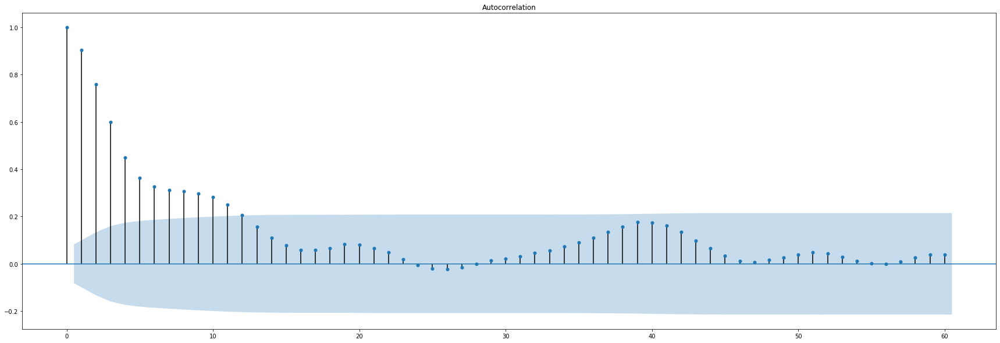

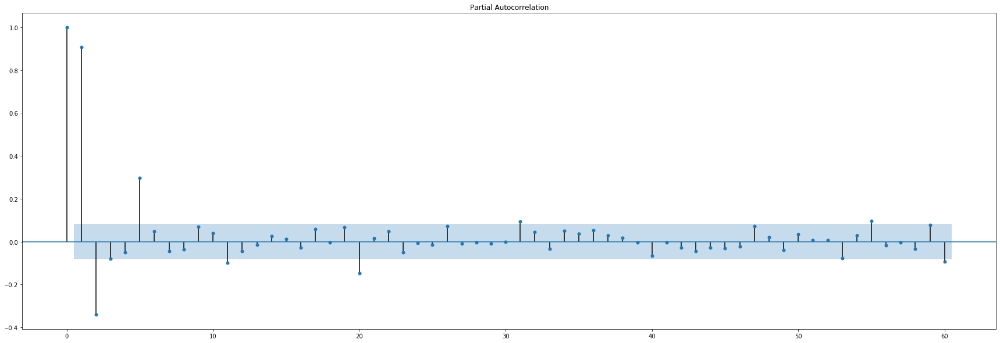

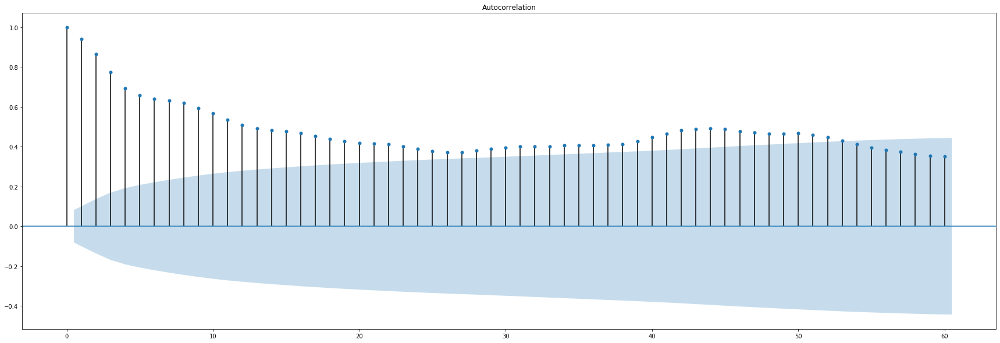

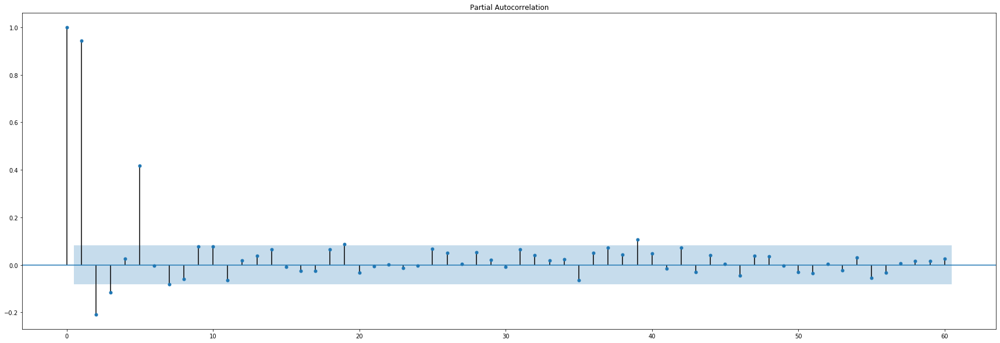

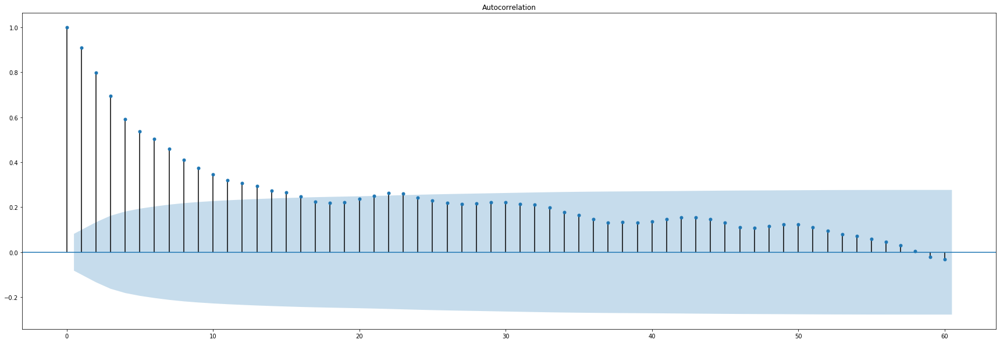

...

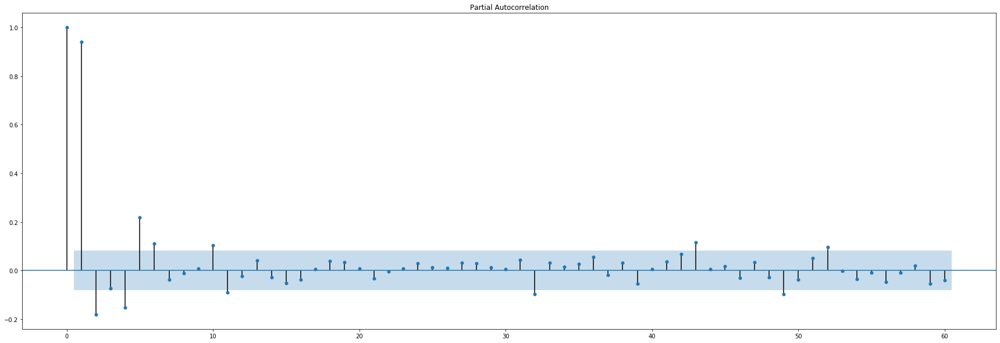

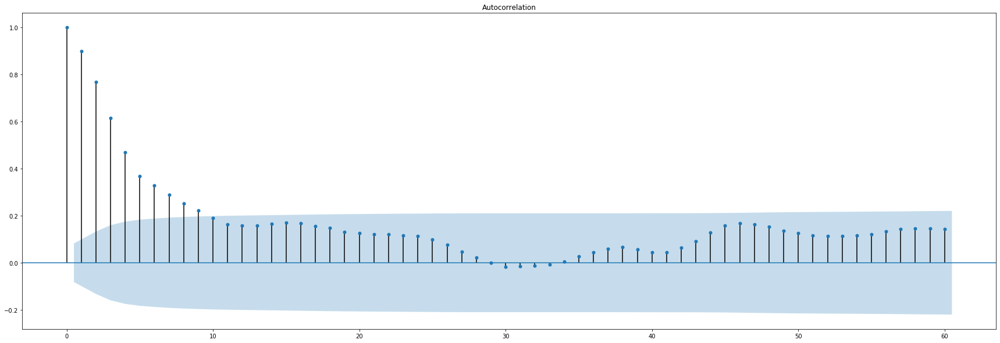

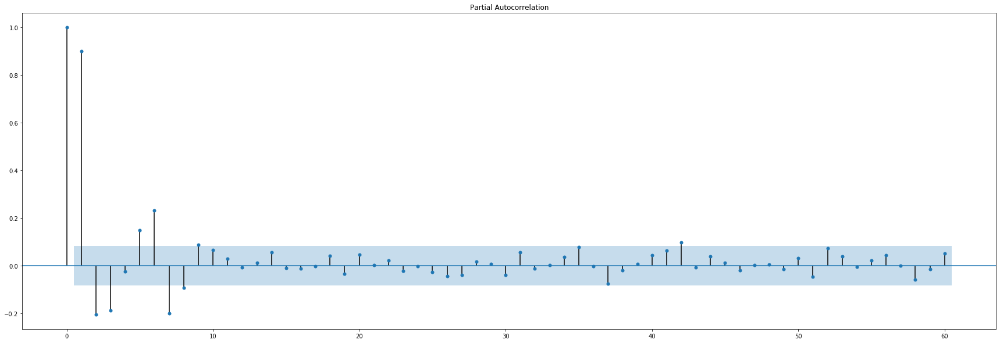

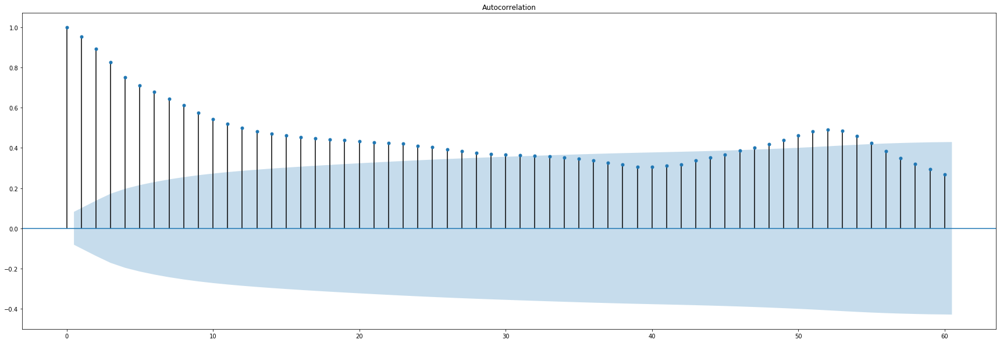

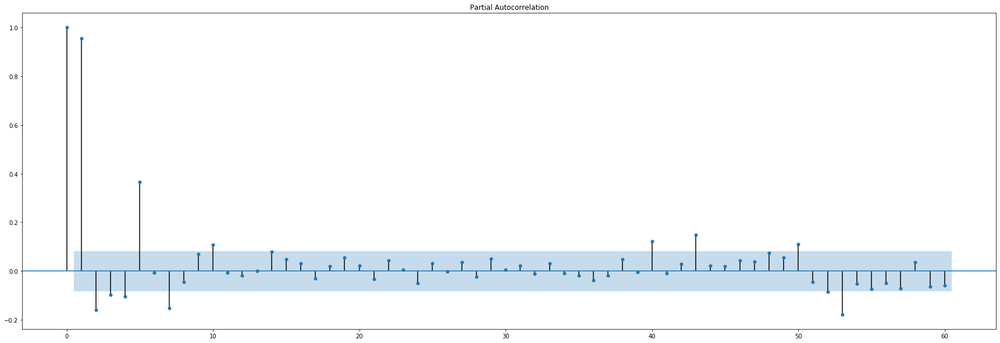

In [52]:
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
import matplotlib as mpl

for ts,listOfTopTen in enumerate(np.argsort(Y_valid)[:,:,-10:][0]):
    #print(ts,listOfTopTen)
    for i in listOfTopTen:
        series = pd.DataFrame(np.transpose(np.vstack([Y_train[:,ts,i]])),columns=["Y_train"])
        with mpl.rc_context():
            mpl.rc("figure", figsize=(30,10))
            plot_acf(series,lags=60)
            plot_pacf(series,lags=60)

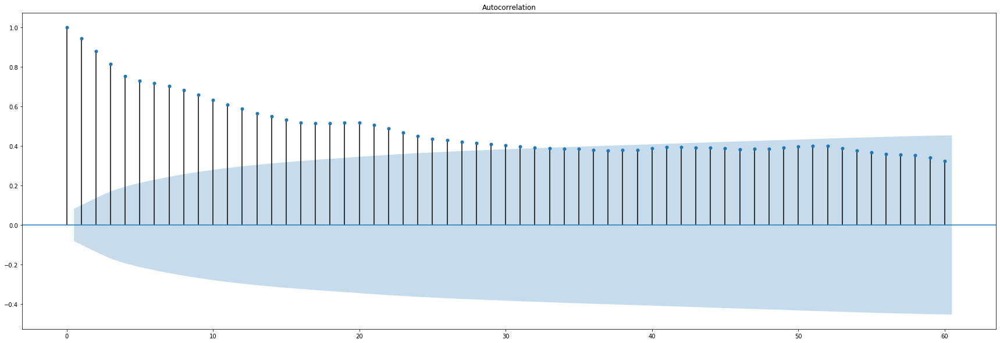

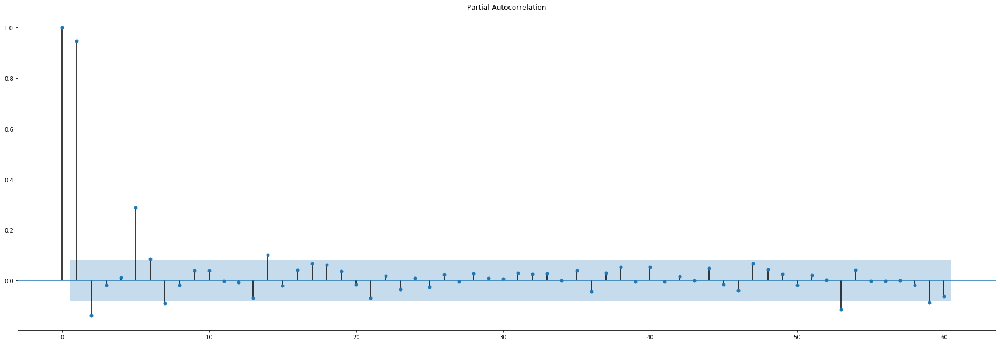

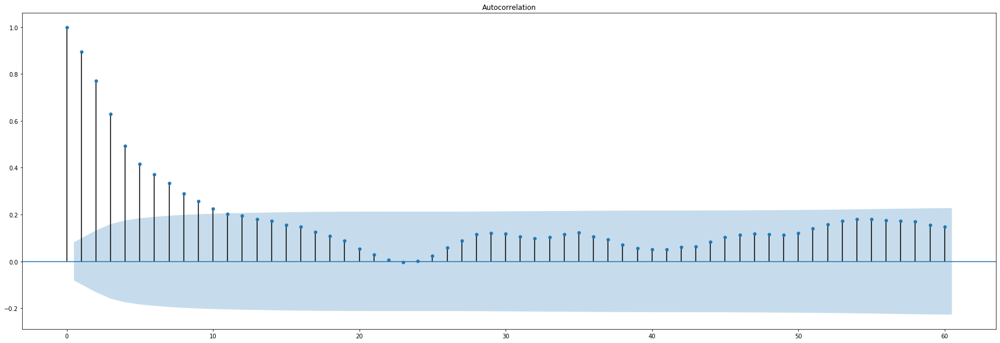

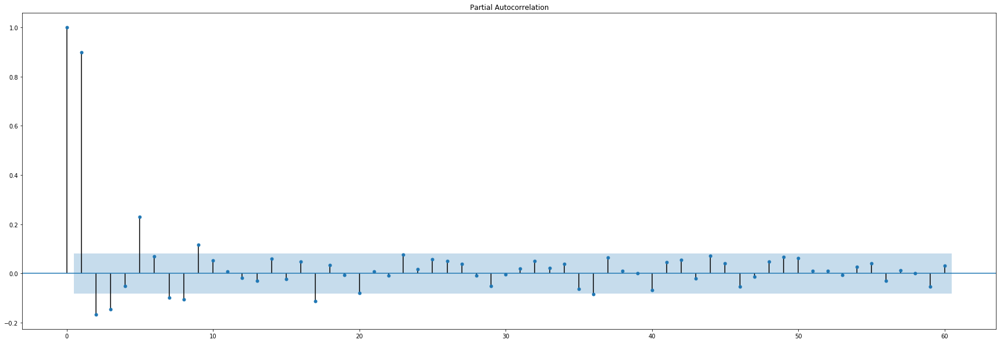

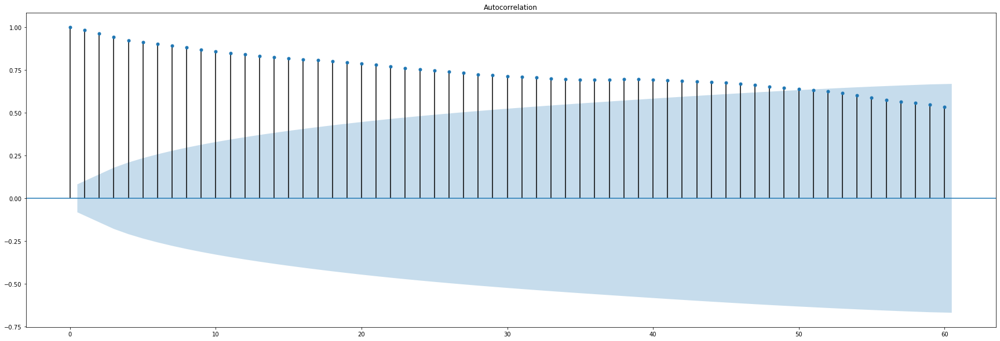

...

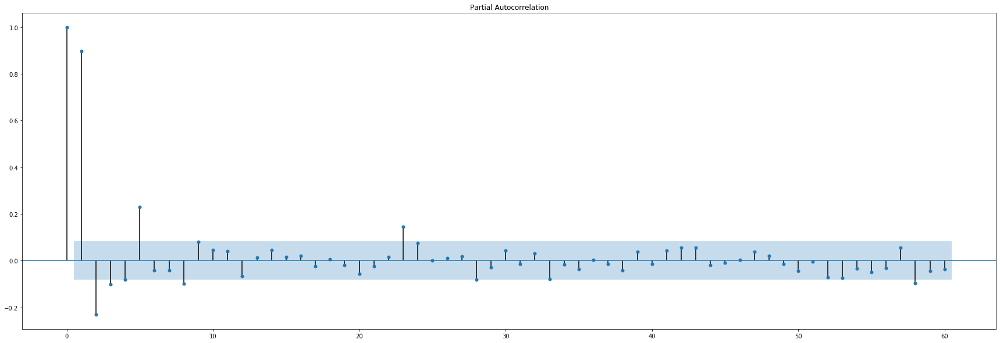

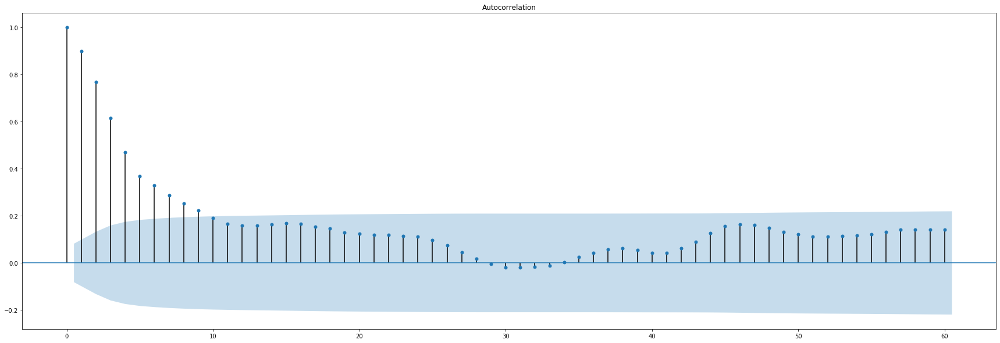

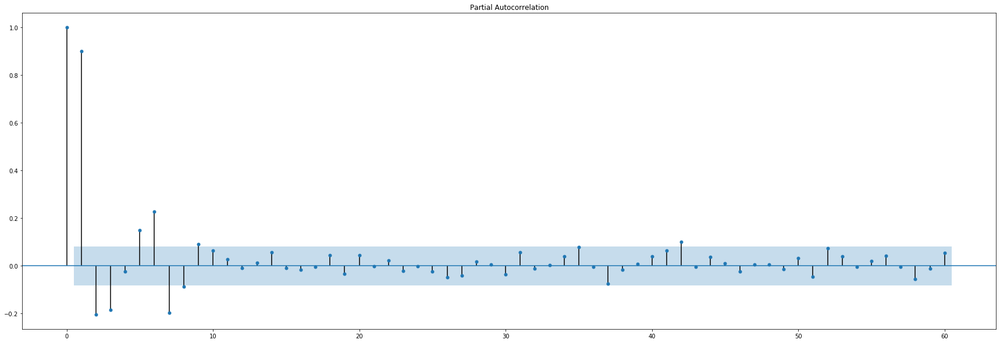

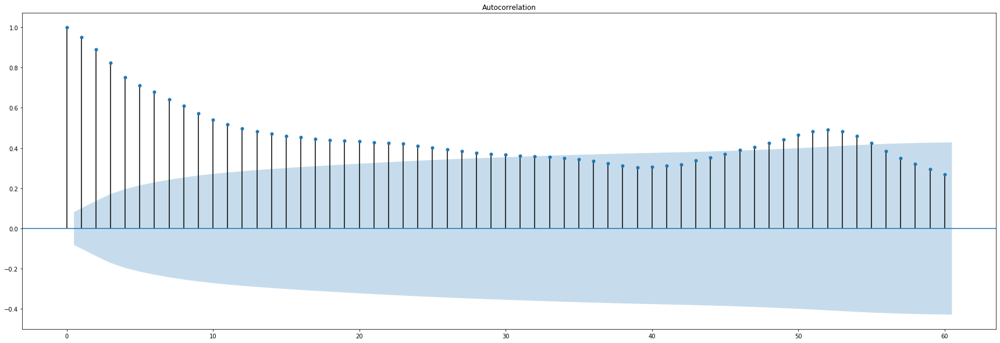

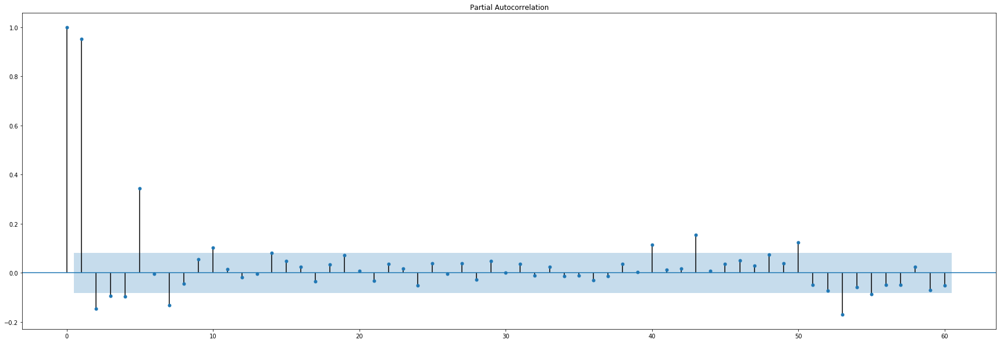

In [153]:
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
import matplotlib as mpl

for i in np.argsort(Y_train)[:,-10:][0]:
    series = pd.DataFrame(np.transpose(np.vstack([Y_train[:,i]])),columns=["Y_train"])
    with mpl.rc_context():
        mpl.rc("figure", figsize=(30,10))
        plot_acf(series,lags=60)
        plot_pacf(series,lags=60)

#### Benchmark prediction

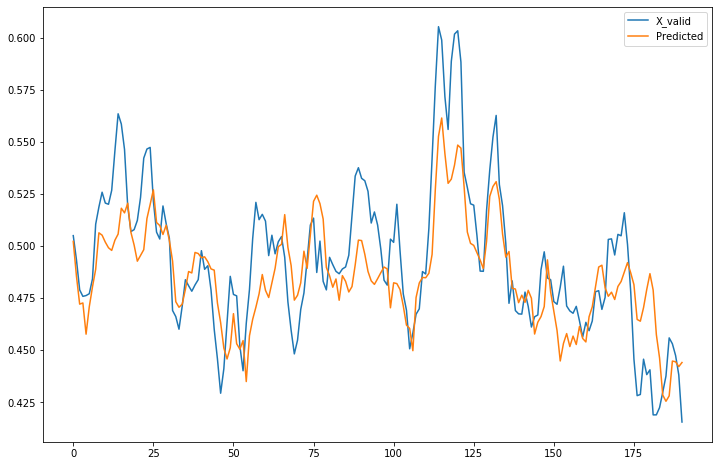

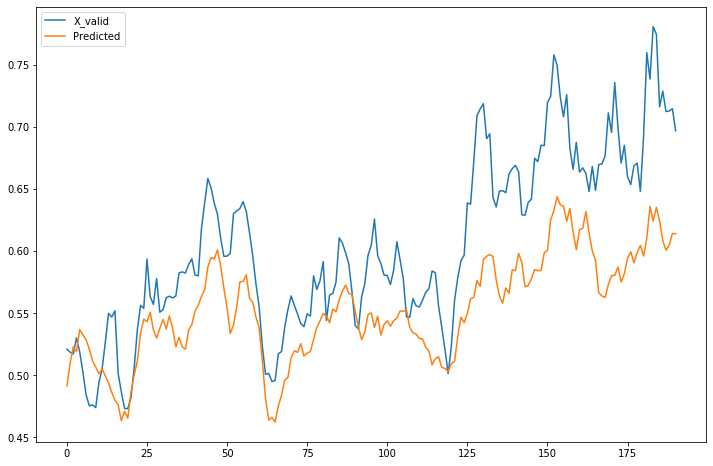

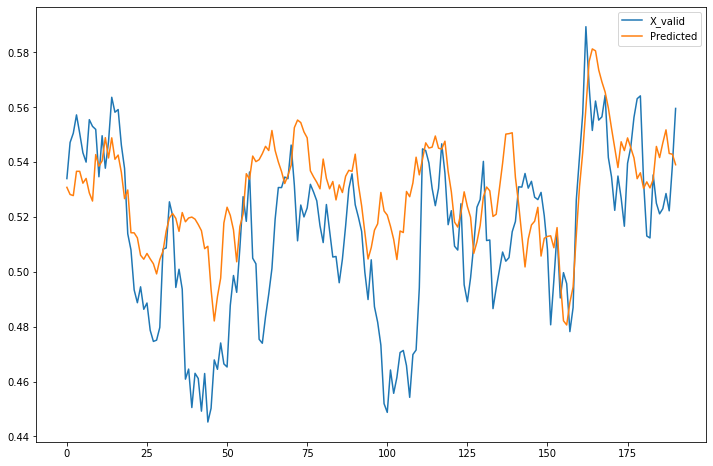

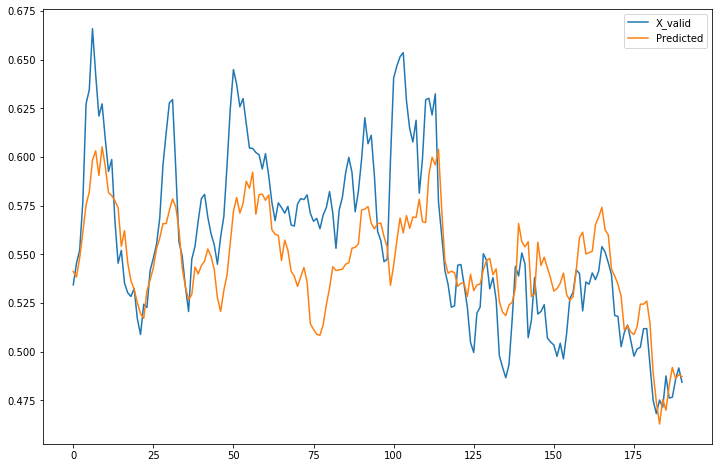

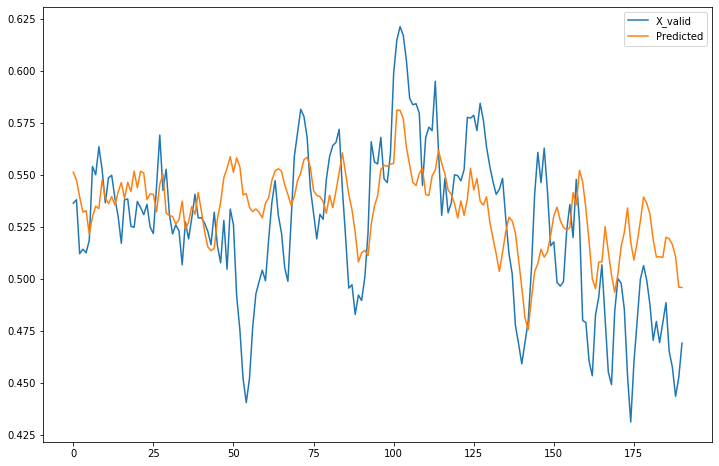

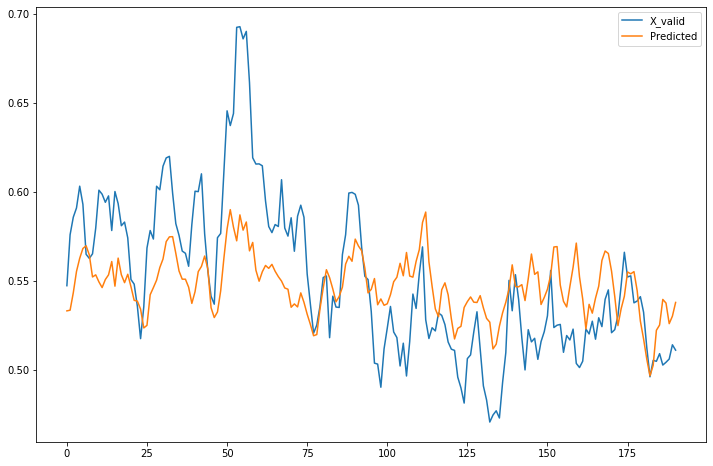

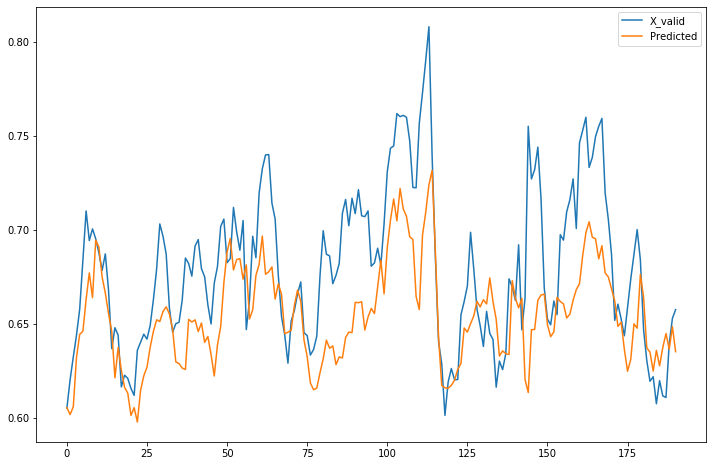

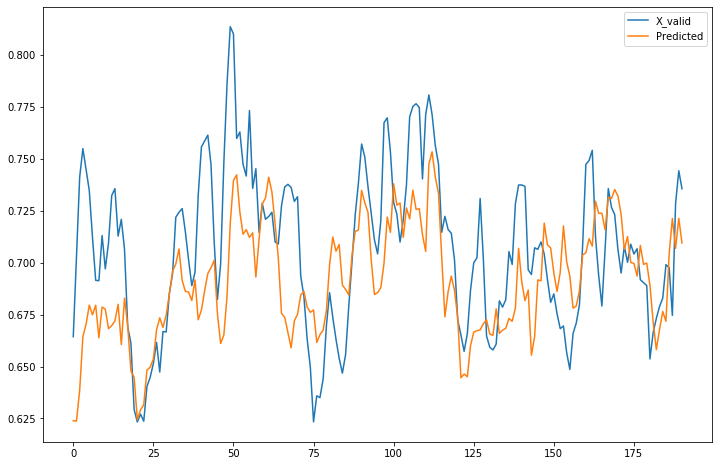

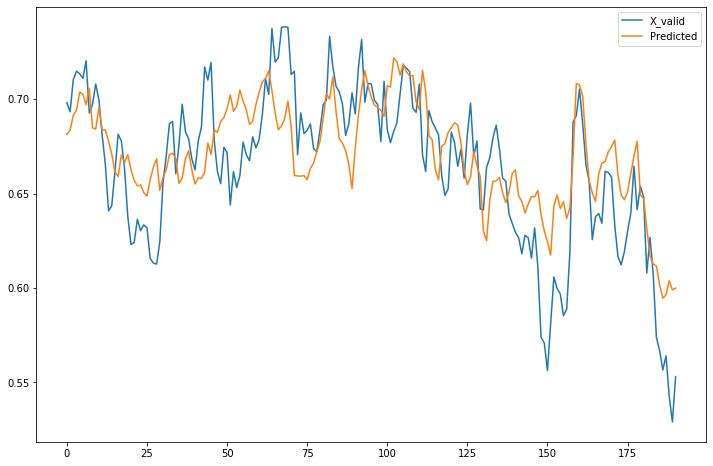

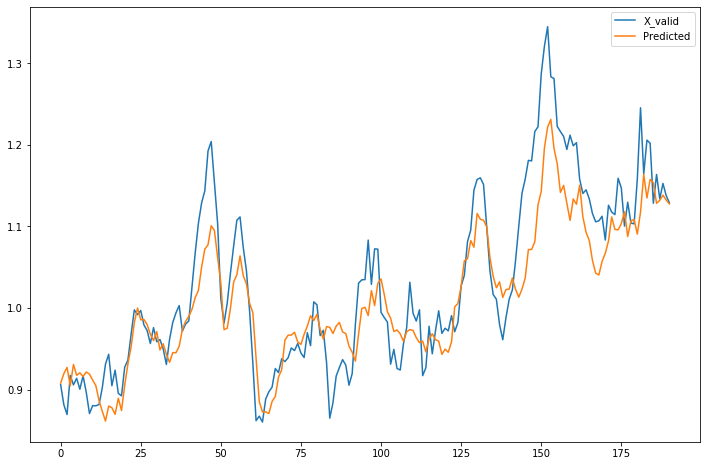

In [252]:
Predict = model.predict([X_valid,h_startv, c_startv])
for i in np.argsort(Y_valid)[:,-10:][0]:
    pd.DataFrame(np.transpose(np.vstack([Y_valid[:,i],Predict[:,i]])),columns=["X_valid","Predicted"]).plot(figsize=(12,8))

#### ENC_LSTM LSTM Attention

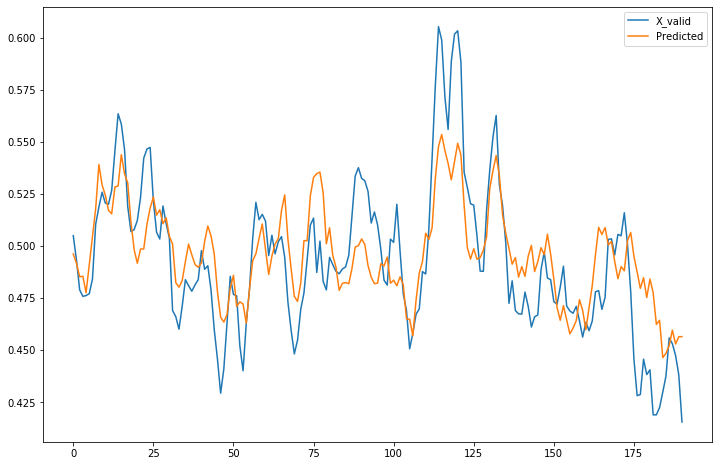

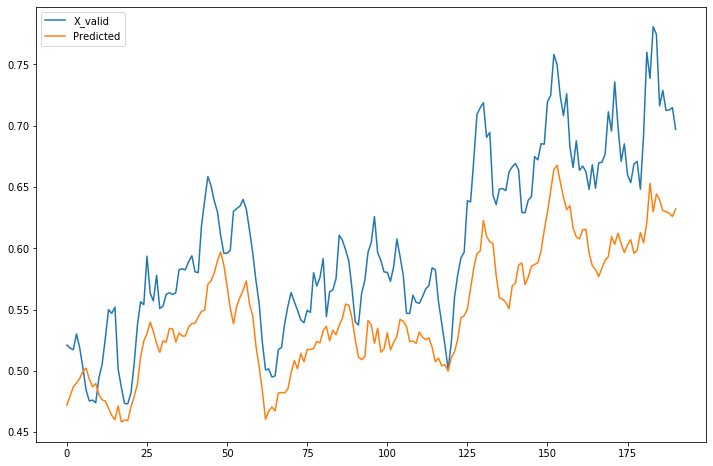

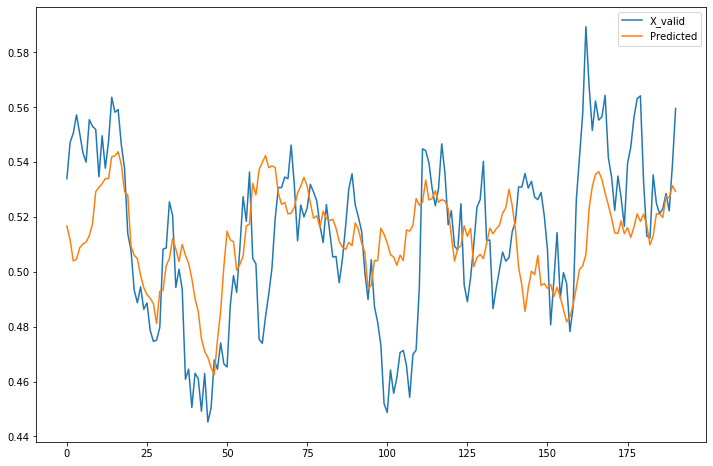

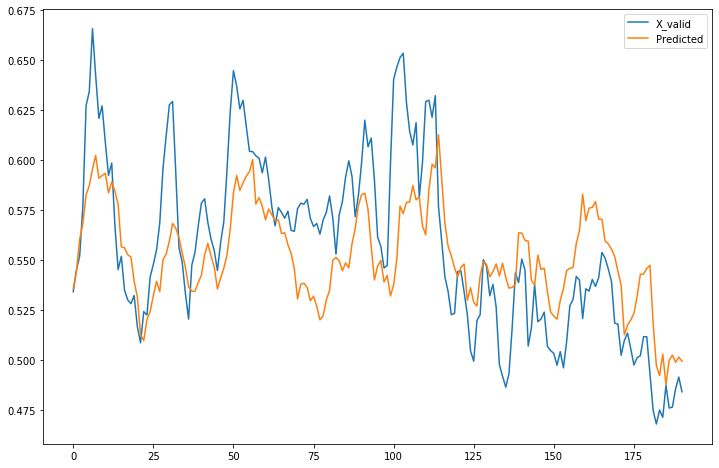

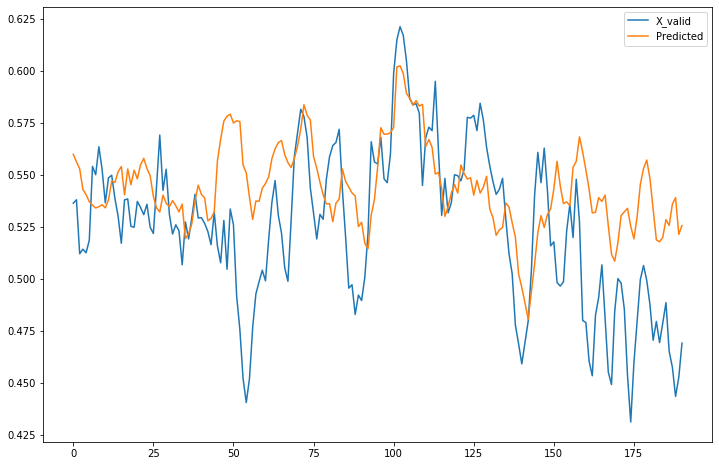

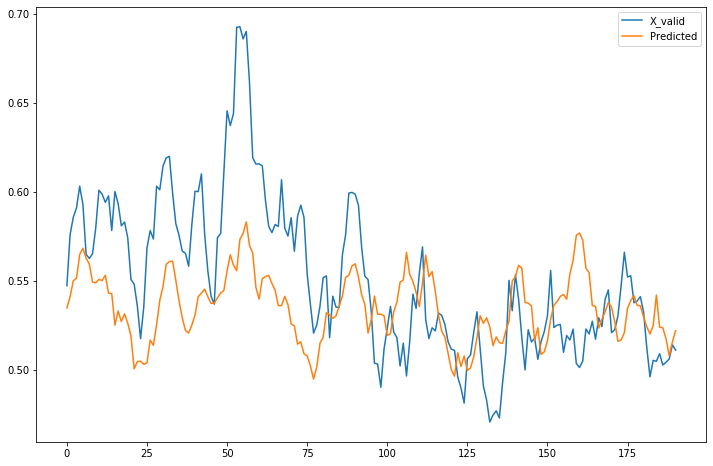

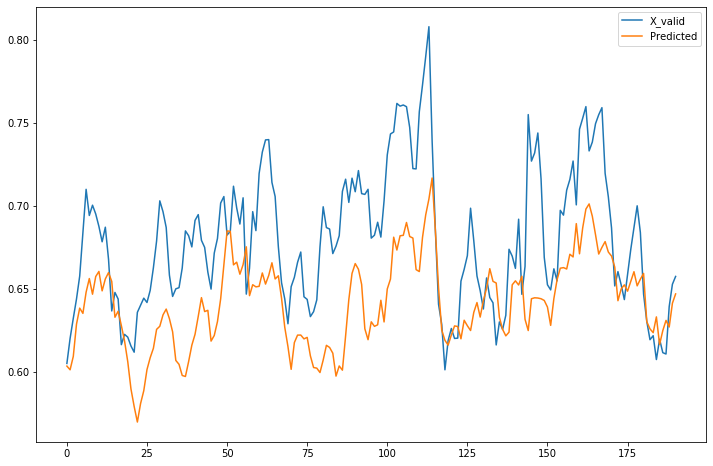

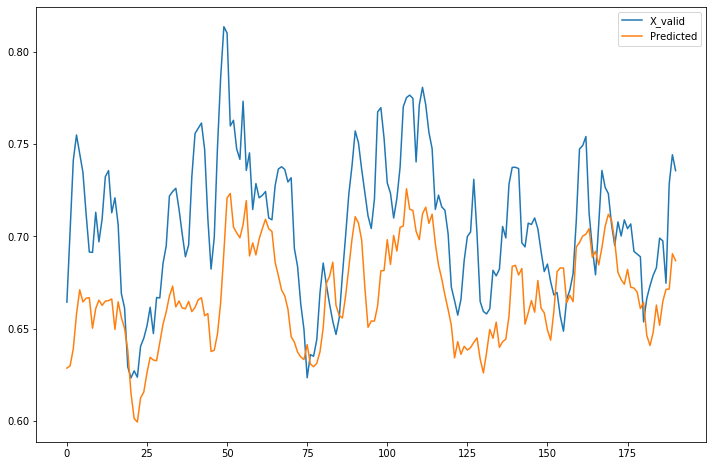

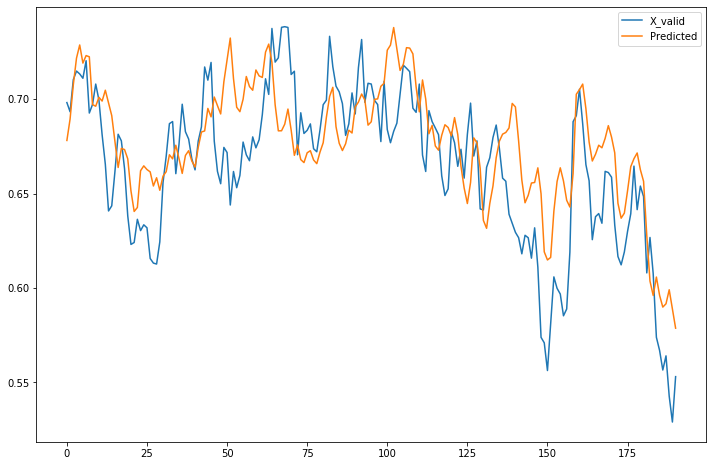

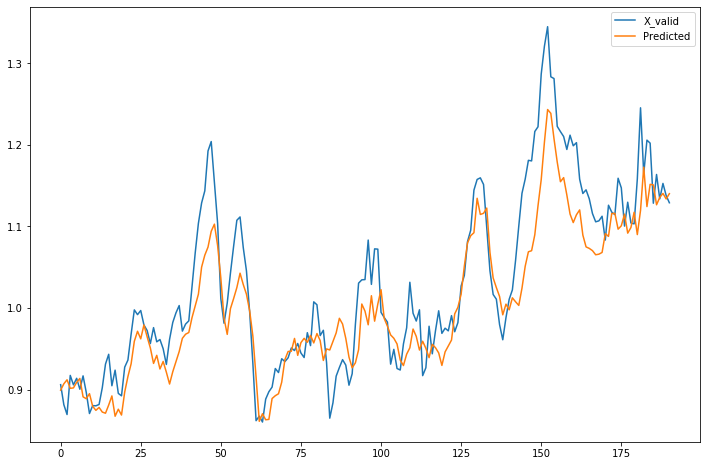

In [325]:
Predict = model.predict([X_valid,h_startv, c_startv])
for i in np.argsort(Y_valid)[:,-10:][0]:
    pd.DataFrame(np.transpose(np.vstack([Y_valid[:,i],Predict[:,i]])),columns=["X_valid","Predicted"]).plot(figsize=(12,8))

/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app
/home/zhimin90/anaconda3/envs/venv/lib/python3.7/site-packages/ipykernel_launcher.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explic

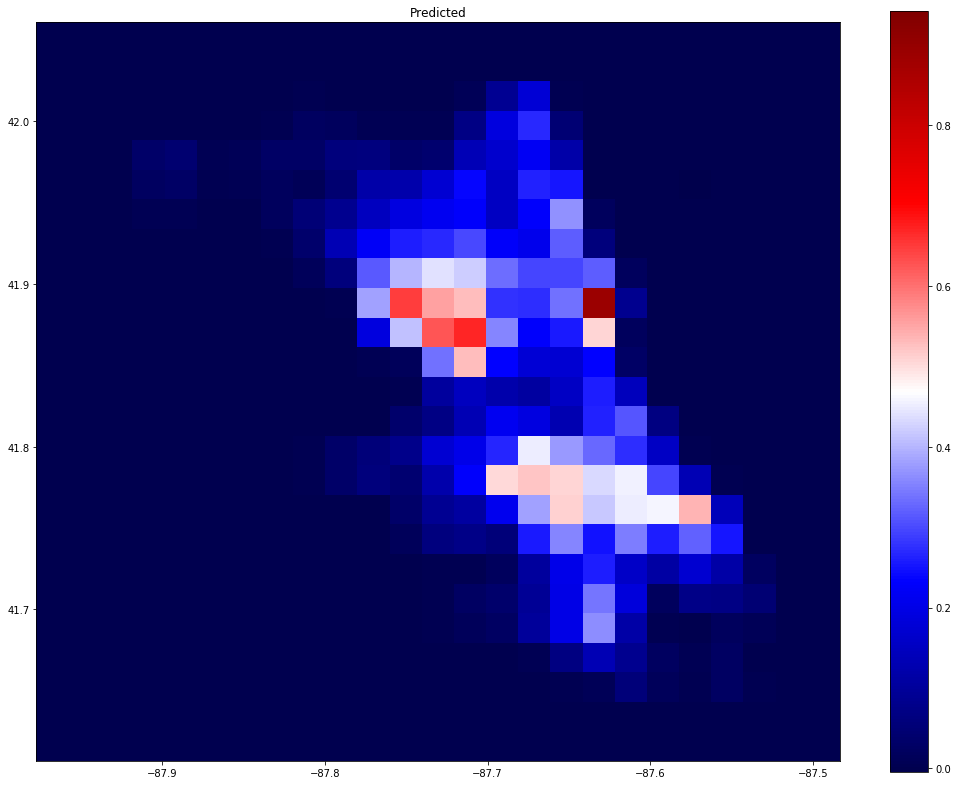

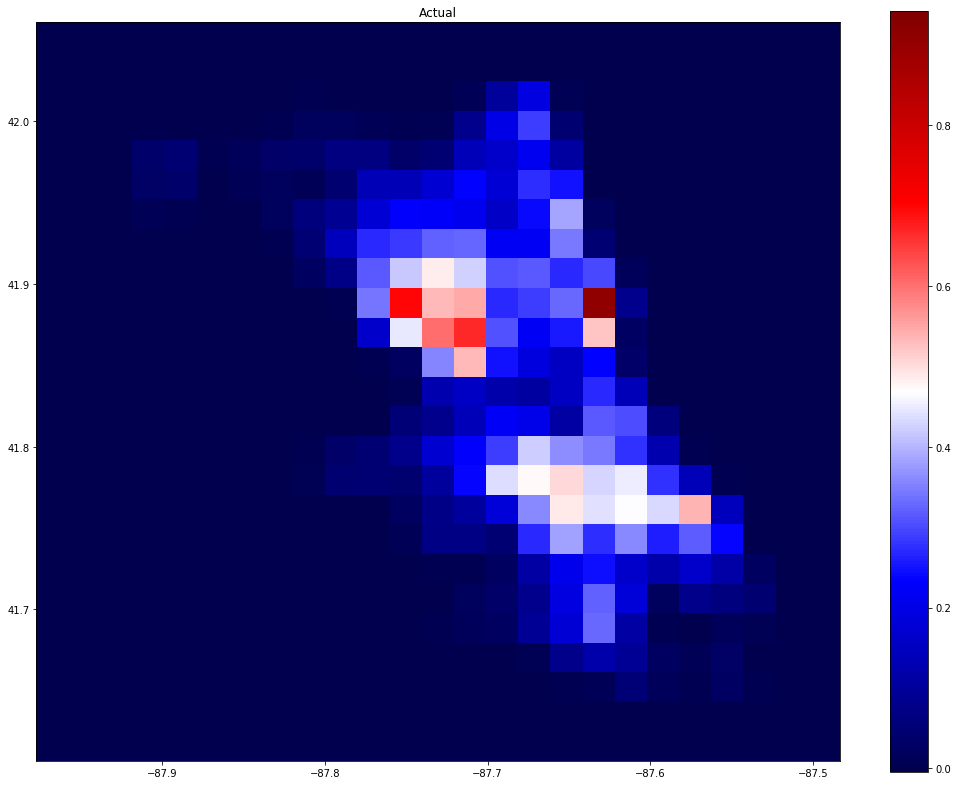

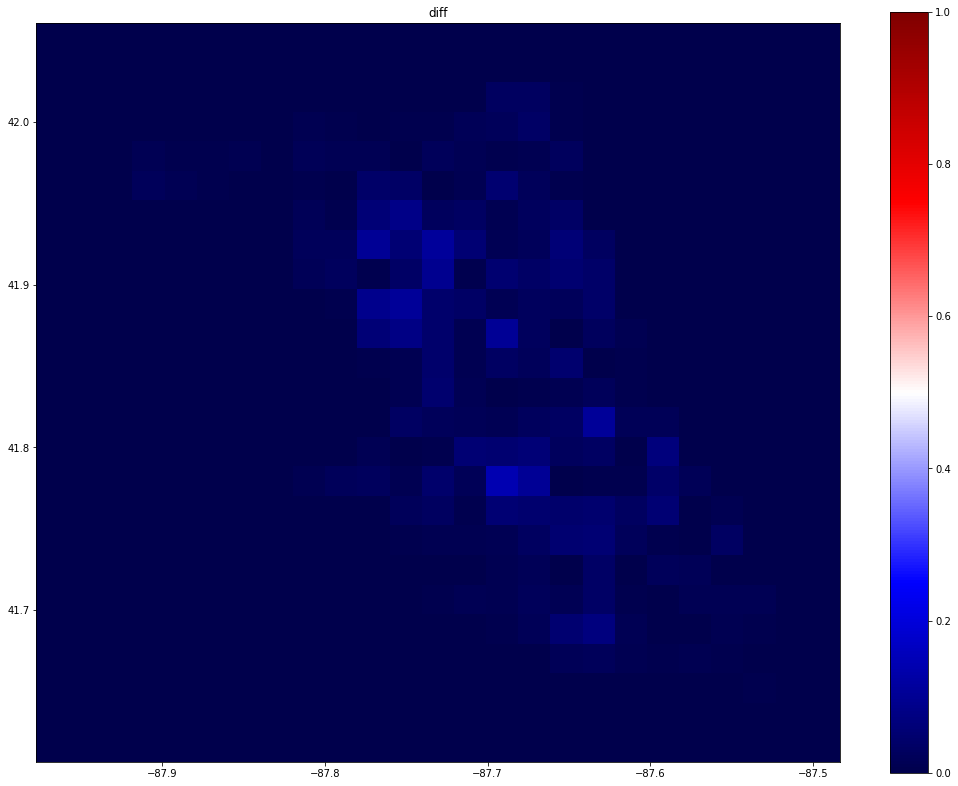

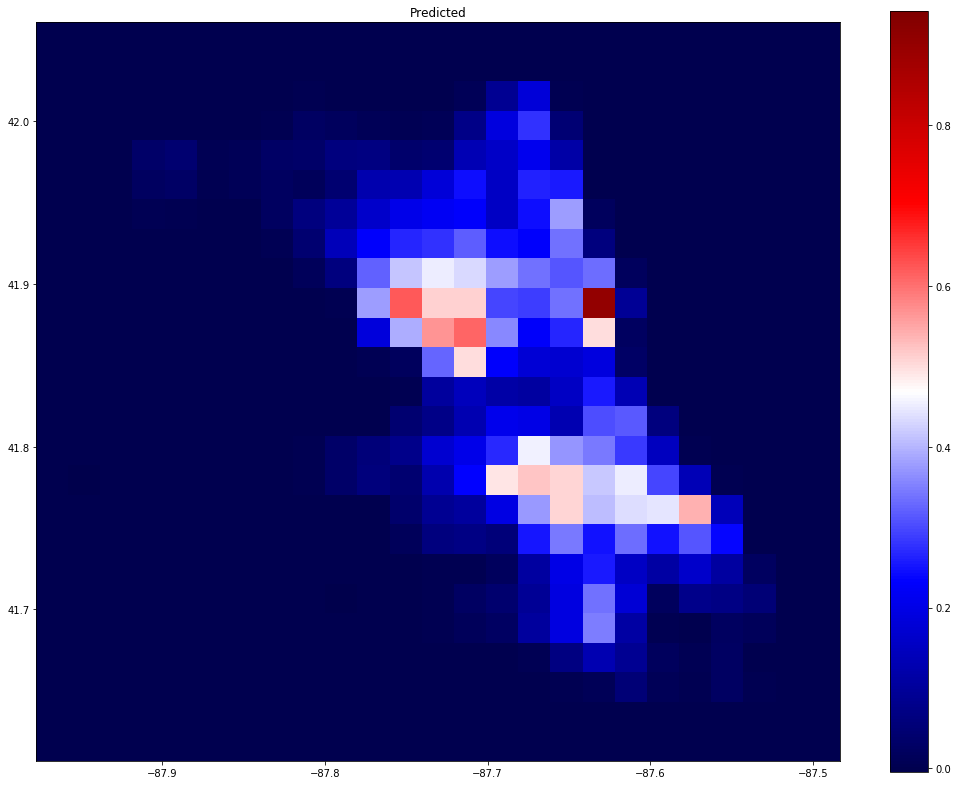

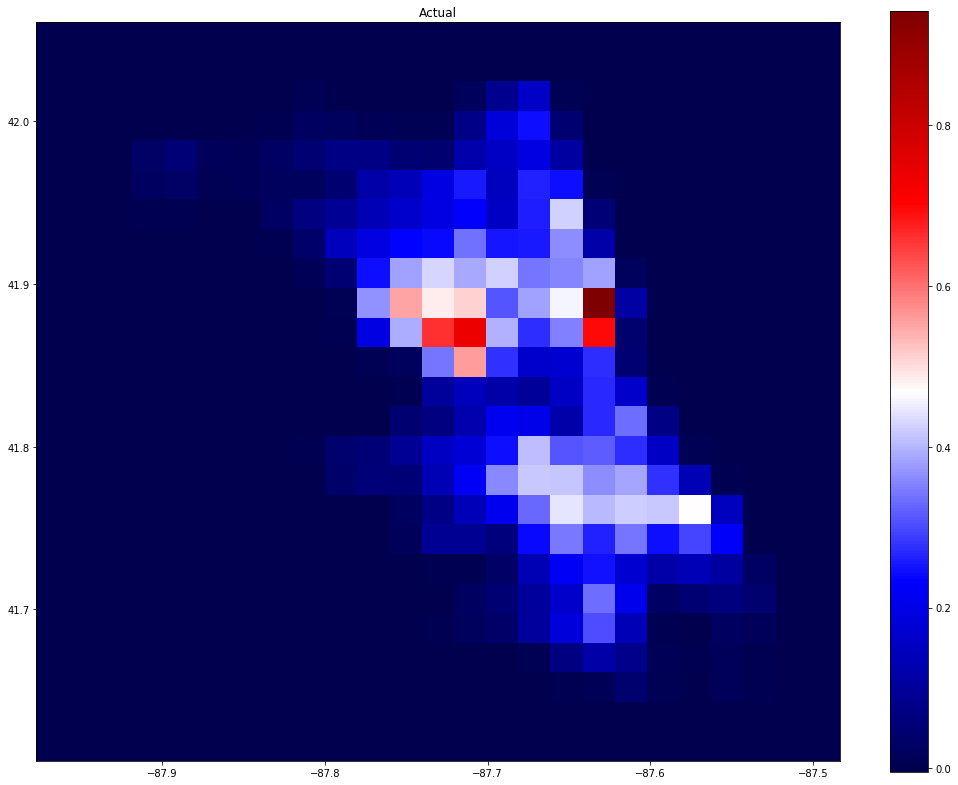

...

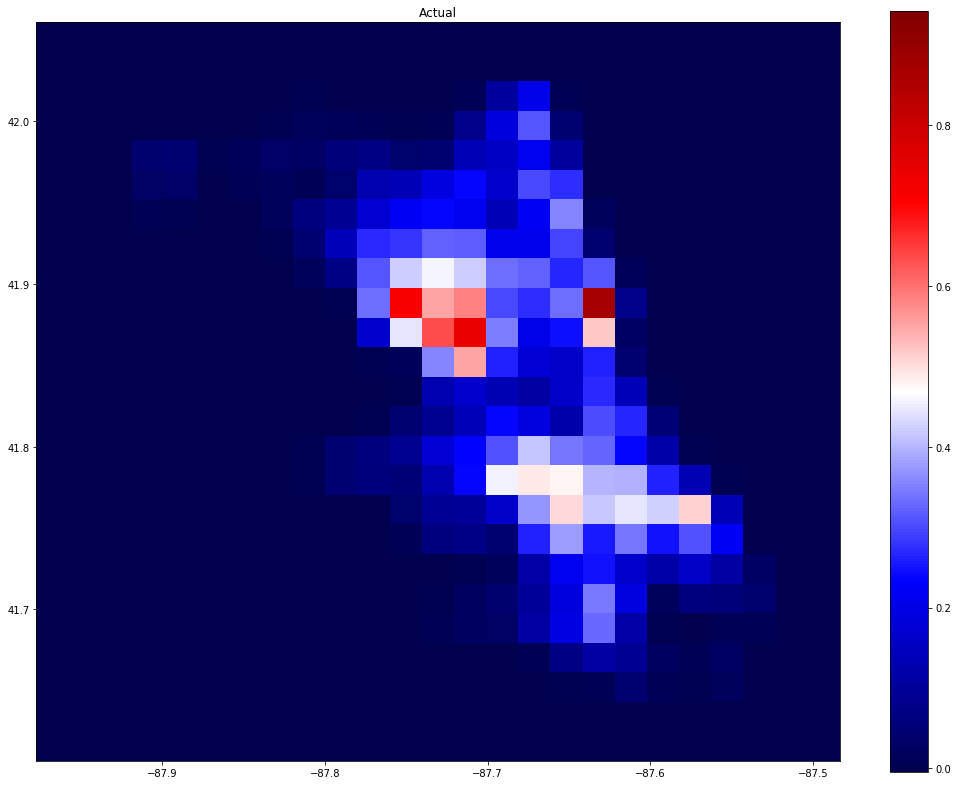

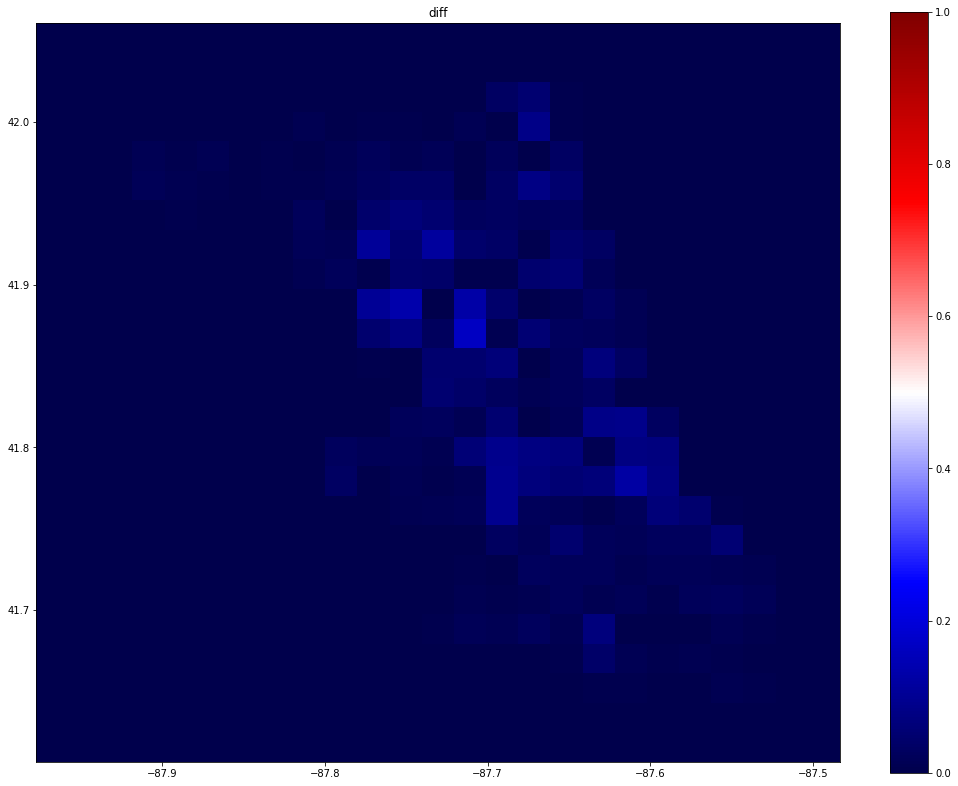

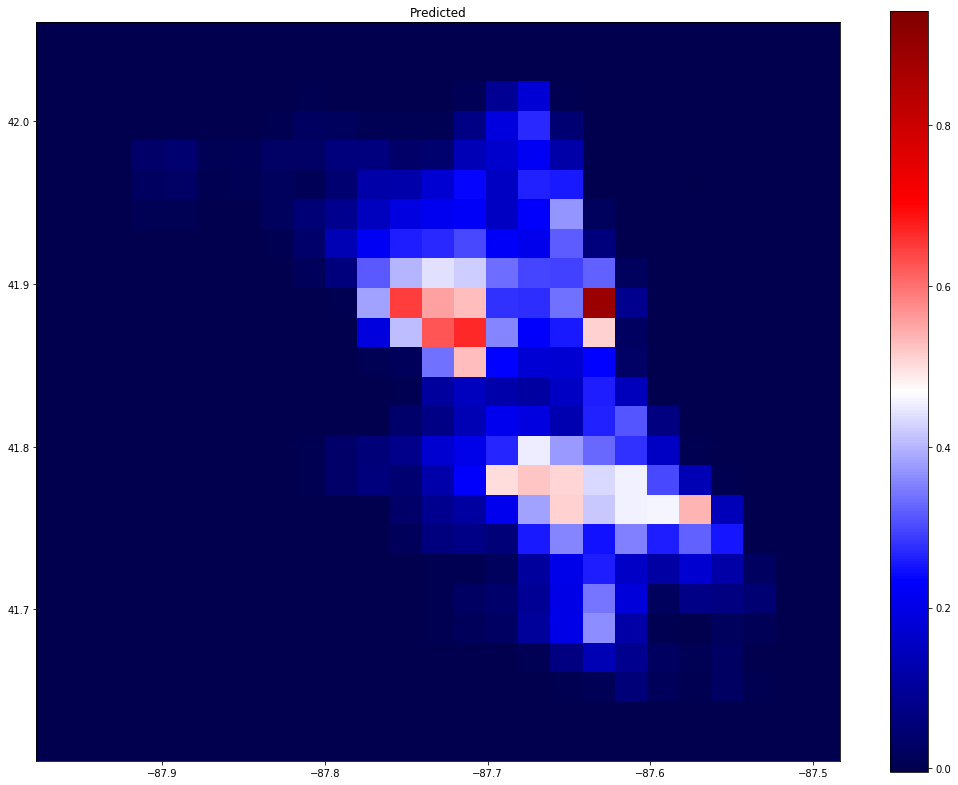

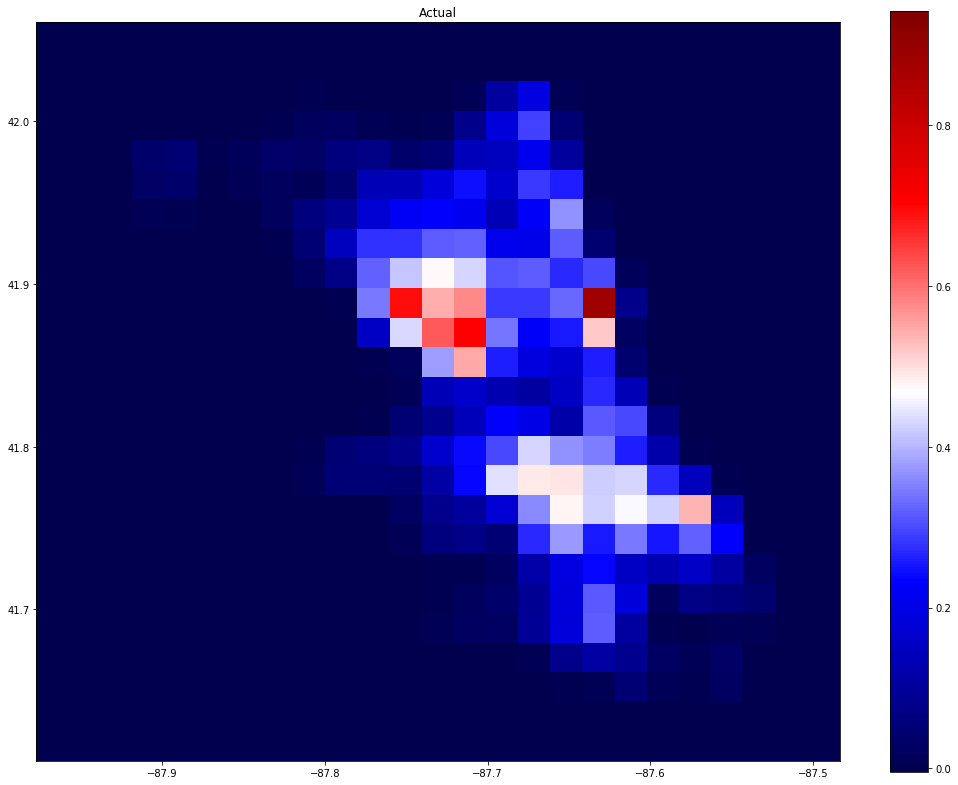

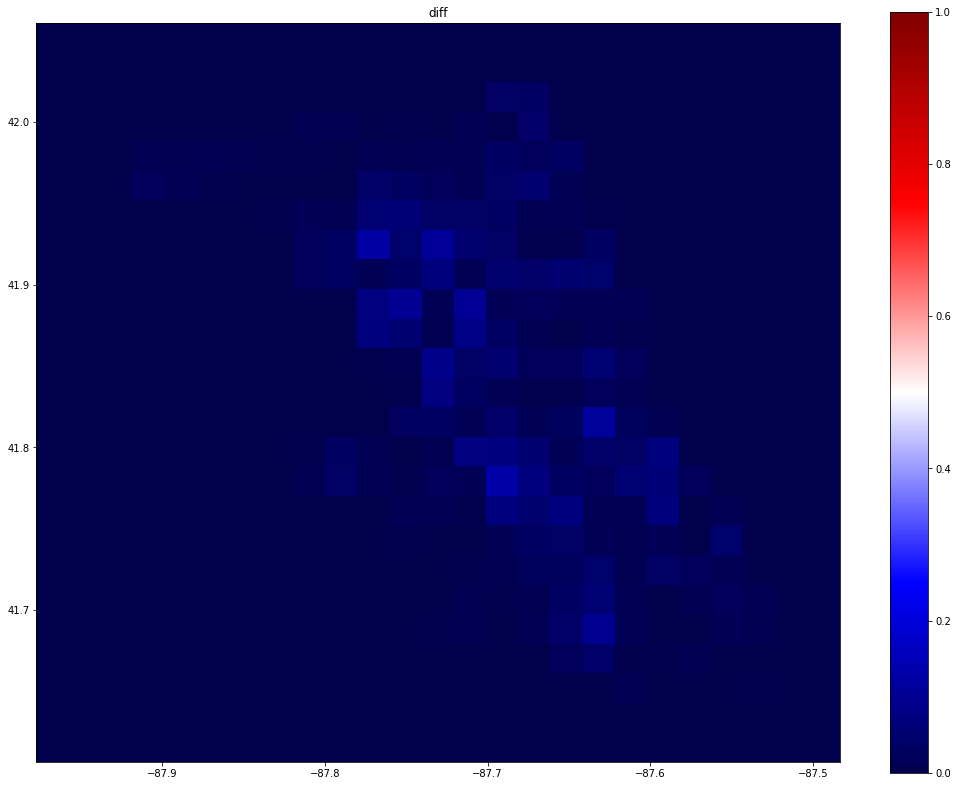

In [155]:
import matplotlib.pyplot as plt
grid_size = 500
density_matrix_t_series = []
# Define the borders
x = [-87.9361,-87.5245]
y = [41.6447,42.023]
deltaX = (max(x) - min(x))/10
deltaY = (max(y) - min(y))/10
xmin = min(x) - deltaX
xmax = max(x) + deltaX
ymin = min(y) - deltaY
ymax = max(y) + deltaY

for timeStepFromLast in range(Y_valid.shape[0]):
    plt.figure(figsize=(18, 14))
    plt.title('Predicted')
    plt.imshow( X=reshapePred(Predict,timeStepFromLast),vmax=vmax,vmin=vmin, cmap=plt.cm.seismic, extent=[xmin, xmax, ymin, ymax])
    plt.colorbar()
    
    plt.figure(figsize=(18, 14))
    plt.title('Actual')
    plt.imshow( X=reshapePred(Y_valid,timeStepFromLast ),vmax=vmax,vmin=vmin, cmap=plt.cm.seismic, extent=[xmin, xmax, ymin, ymax])
    plt.colorbar()
    
    diff = np.abs(reshapePred(Predict,timeStepFromLast)-reshapePred(Y_valid,timeStepFromLast ))
    plt.figure(figsize=(18, 14))
    plt.title('diff')
    plt.imshow( X=scaleDiff(diff,diff_max,diff_min),vmax=1,vmin=0, cmap=plt.cm.seismic, extent=[xmin, xmax, ymin, ymax])
    plt.colorbar()

#### We plot the single pixel with the most dense in crime KDE

In [282]:
Y_valid[:,i+1][1:]-Y_valid[:,i+1][0:-1]

array([-9.01753809e-04,  1.18319356e-02,  6.39541418e-03, -1.00963813e-03,
        2.21520226e-02,  9.82203294e-03,  8.98862978e-04, -1.40180189e-02,
       -2.85536782e-02, -1.55400392e-02,  2.49836335e-03, -6.25528683e-03,
        6.57367428e-03,  1.52411820e-02, -4.17035312e-03, -3.49904935e-03,
        1.69208642e-02, -6.37871144e-03,  3.80110476e-03,  3.35229609e-02,
        6.12156350e-03,  4.98861189e-04,  3.92699759e-03, -6.97102683e-03,
       -8.97786049e-03,  1.45726198e-02,  3.08736283e-03, -5.16823240e-03,
        4.67295254e-03, -1.55889985e-02, -1.86007998e-02, -5.75143199e-03,
       -4.28169510e-03,  5.93364074e-03,  7.45896358e-03, -3.70727537e-04,
        1.66578132e-02, -1.82307174e-02,  1.18449802e-03,  6.59418153e-03,
       -1.84222292e-02, -1.27048644e-02,  9.62644994e-03, -7.42424322e-03,
        6.96875199e-03,  2.01487532e-02,  3.60732578e-03,  2.75561154e-03,
       -5.55466216e-03, -1.54981214e-02, -1.23346509e-02,  3.42596063e-03,
        1.33056411e-02, -

In [283]:
[Y_valid[:,i+1][1:]-Y_valid[:,i+1][0:-1]
 ,Y_valid[:,i+1][1:]-Y_valid[:,i+1][0:-1]]

[array([-9.01753809e-04,  1.18319356e-02,  6.39541418e-03, -1.00963813e-03,
         2.21520226e-02,  9.82203294e-03,  8.98862978e-04, -1.40180189e-02,
        -2.85536782e-02, -1.55400392e-02,  2.49836335e-03, -6.25528683e-03,
         6.57367428e-03,  1.52411820e-02, -4.17035312e-03, -3.49904935e-03,
         1.69208642e-02, -6.37871144e-03,  3.80110476e-03,  3.35229609e-02,
         6.12156350e-03,  4.98861189e-04,  3.92699759e-03, -6.97102683e-03,
        -8.97786049e-03,  1.45726198e-02,  3.08736283e-03, -5.16823240e-03,
         4.67295254e-03, -1.55889985e-02, -1.86007998e-02, -5.75143199e-03,
        -4.28169510e-03,  5.93364074e-03,  7.45896358e-03, -3.70727537e-04,
         1.66578132e-02, -1.82307174e-02,  1.18449802e-03,  6.59418153e-03,
        -1.84222292e-02, -1.27048644e-02,  9.62644994e-03, -7.42424322e-03,
         6.96875199e-03,  2.01487532e-02,  3.60732578e-03,  2.75561154e-03,
        -5.55466216e-03, -1.54981214e-02, -1.23346509e-02,  3.42596063e-03,
         1.3

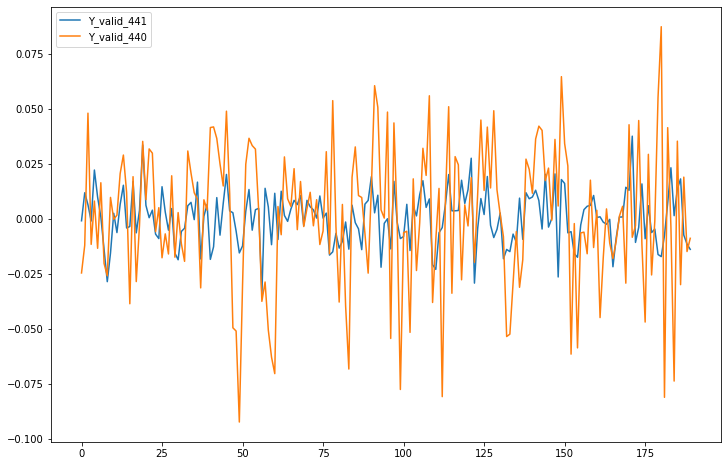

In [284]:
pd.DataFrame(np.transpose(np.vstack([Y_valid[:,i+1][1:]-Y_valid[:,i+1][0:-1],Y_valid[:,i][1:]-Y_valid[:,i][0:-1]])),columns=["Y_valid_"+str(i+1),"Y_valid_"+str(i)]).plot(figsize=(12,8))

In [182]:
for i in range(Predict.shape[0]-1):
    diff_ts = Predict[i,:] - Predict[i+1,:]
    print(np.sum(diff_ts[np.argsort(diff_ts)]))

-0.018348634
-0.016021848
0.015775248
0.020925283
0.045273706
0.03128943
0.018040925
-0.00502263
-0.02631709
-0.013405532
-0.0017083734
-0.013218492
0.0045014173
0.017989665
0.009978518
0.008973703
0.014333576
-0.0049110055
-0.020244107
-0.022466868
-0.040362597
-0.045676887
-0.024351493
0.019487843
0.04735197
0.0633508
0.053164914
0.013827905
-0.019466996
-0.028476924
-0.0130241215
0.02217567
0.04528658
0.046599343
0.03545305
0.0024482757
-0.01050134
-0.009597987
0.004566729
-0.008940145
-0.00509423
-0.005364269
-0.010164425
-0.015671536
-0.0077869743
-0.01051566
-0.049754962
-0.04241468
-0.028206766
-0.0001823008
0.07727072
0.061968148
0.01799655
-0.047201604
-0.07962313
-0.08635062
-0.01418215
0.005559683
0.053069443
0.056287825
0.03908366
-0.0066076815
-0.024781823
-0.035811573
-0.016936183
-0.00874117
0.021601647
0.0020243526
-0.0074737966
-0.008401036
-0.0012931526
0.028078198
0.038011193
0.017500311
0.005063951
-0.025907993
-0.036359817
-0.050627694
0.0023586303
-0.010886669
0.0

#### We plot the difference between prediction and target

In [183]:
diff = (reshapePred(Y_valid,3)-reshapePred(Predict,3))
diff.shape

(25, 25)

In [184]:
diff_max = np.max(diff)
diff_min = np.min(diff)
scaled_diff = (diff - diff_min)/(diff_max - diff_min)

In [185]:
np.max(scaled_diff)

1.0

In [186]:
diff

array([[-1.67235569e-03, -3.23733548e-04,  5.95766352e-04,
        -1.37537951e-04,  1.76841160e-04, -3.81134800e-04,
         2.69784126e-04,  1.77089707e-04,  1.05850736e-03,
         9.53653420e-04,  3.19143641e-04, -2.29958678e-05,
        -2.26227596e-04, -7.21998978e-04,  7.96711422e-04,
         1.71949388e-04,  3.67081026e-04, -2.15561362e-04,
         2.58697488e-04,  5.21506066e-04, -5.16083091e-05,
        -9.78268217e-04, -9.02256346e-04, -1.38947275e-03,
         7.24554178e-04],
       [ 2.90377066e-04,  7.12244539e-04, -4.19916818e-04,
         1.67926308e-04,  9.38627461e-04, -3.83002101e-04,
        -8.67697876e-04, -8.38714186e-06,  8.89419112e-04,
        -3.53584765e-05,  2.69406009e-05, -4.64310055e-04,
         5.50329569e-05, -1.67888240e-03,  1.70630403e-04,
        -2.00605951e-04,  1.23288529e-03, -1.12075359e-05,
         4.61907068e-04, -1.61501090e-03,  3.22510488e-04,
         7.08120642e-04,  1.06346037e-03,  3.36882658e-05,
        -1.00405794e-03],
    

In [187]:
vmax, vmin = np.max(scaled_diff), np.min(scaled_diff)

In [188]:
vmax, vmin 

(1.0, 0.0)

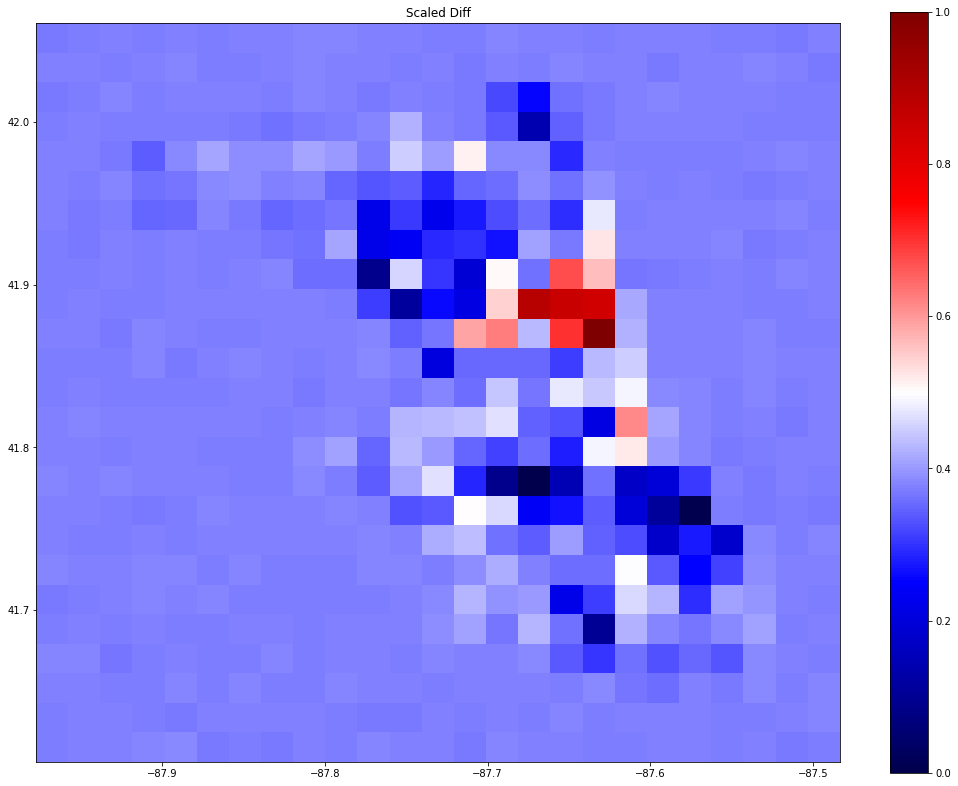

In [190]:
plt.figure(figsize=(18, 14))
plt.title('Scaled Diff')
plt.imshow( X=scaled_diff,vmax=vmax, vmin=vmin, cmap=plt.cm.seismic, extent=[xmin, xmax, ymin, ymax])
plt.colorbar()

#### Note the differences is scaled, red means extreme differences inplot above. Interestingly we see the extreme differences is at the highest crime areas.